## Goal:
- Simultaneously train Autoencoder and Classifier

## Structure: 

- Zero-grad encoder_optimizer and decoder_optimizer
- Encoder --> Z
    - For all data: Apply Decoder --> MSE Loss; 
    - For labeled data:
        - Zero-grad classifier_optimizer
        - Apply CLassifier --> BCE Loss; 
    - Minibatch_loss = MSE Loss * alpha + BCE Loss (Note: Alpha to bring MSE Loss and BCE Loss to the same scale)
    - Minibatch_loss.backward()
    - Encoder_optimizer.step(), Decoder_optimizer.step(), Classifier_optimizer.step()
    
## Lessons Learned
- Images not black and white, then do not normalized it
- Images not black and white, then use MSE loss instead of BCE Loss
- For natural images, you may normalize it
- For Encoder:
    - If pixels are not normalized and in the range of 0, 1, then do Sigmoid
    - If pixels are normalized and have negative values, then do tanh
- For model structure:
    - Encoder: try to add conv2D layers to make the last layer smaller, before doing view
    - Decoder:
        - for simple tasks, no need for a big decoder
        - try to get the tensor size closer to the reconstructed image, before doing upsampling
        - if upsampling, should upsample width and height with same rato
- Simultaneous training:
    - Autoencoder on all images, classification on labeled data
    - Bring losses to the same scale to put equal weights on autoencoder and classification
    - Add losses before backward
- Model.train() is different from model.eval(). If we want to evaluate, put the model to eval mode

In [4]:
#%load_ext autotime

In [ ]:
#!conda install pandas

In [2]:
import os
import pandas as pd
import numpy as np
import zipfile
import gzip
%load_ext autoreload
%autoreload 2

# import cv2
import matplotlib.pyplot as plt
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils, models
from sklearn.metrics import roc_auc_score
from torchvision import models
from torch import nn
from torch import optim
from torch.autograd import Variable
import time
import copy

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cpu')

In [ ]:
graph_path = '../models'
data_path = '../data'

## Prepare Image Data

In [4]:
class DeviceDataset(Dataset):
    """Face Landmarks dataset."""

    def __init__(self, csv_file, root_dir, transform=None):
        """
        Args:
            csv_file (string): Path to the csv file with annotations.
            root_dir (string): Directory with all the images.
            transform (callable, optional): Optional transform to be applied
                on a sample.
        """
        self.device_frame = pd.read_csv(csv_file)
        self.root_dir = root_dir
        self.transform = transform

    def __len__(self):
        return len(self.device_frame)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
            
        image_id = self.device_frame.loc[idx, 'serial_nr'] + '_' + self.device_frame.loc[idx, 'dispatch_id']
        image_label = self.device_frame.loc[idx, 'fm_rts_label']
        if image_label == 0:
            image_name = os.path.join(self.root_dir, 'match',
                                       image_id) + '.JPG'
        elif image_label == 1:
            image_name = os.path.join(self.root_dir,'mismatch',
                                       image_id)+ '.JPG'
        else:
            image_name = os.path.join(self.root_dir,'uncategorized',
                                       image_id)+ '.JPG'
            
            
        image = cv2.imread(image_name)
        
        if self.transform:
            image = self.transform(image)
        
        sample = {'image': image, 'label': image_label}
        

        return sample

In [5]:
transform = transforms.Compose([  
 transforms.ToPILImage(),
 transforms.Resize(256),
#  transforms.CenterCrop(224),
 transforms.ToTensor(),
#  transforms.Normalize(
#  mean=[0.485, 0.456, 0.406], 
#  std=[0.229, 0.224, 0.225]
#  )
])


In [6]:
root_dir = "../Olaf_data/olaf_images"
data_path = '../Olaf_data'

transformed_train_dataset = DeviceDataset(os.path.join(data_path, '20210301_labeled_train_data.csv'),
                              root_dir=root_dir,
                              transform=transform)
transformed_val_dataset = DeviceDataset(os.path.join(data_path, '20210301_labeled_val_data.csv'),
                              root_dir=root_dir,
                              transform=transform)
transformed_test_dataset = DeviceDataset(os.path.join(data_path, '20210301_labeled_test_data.csv'),
                              root_dir=root_dir,
                              transform=transform)
transformed_downsampled_train_dataset = DeviceDataset(os.path.join(data_path, 'downsampled_train_data.csv'),
                              root_dir=root_dir,
                              transform=transform)
transformed_downsampled_val_dataset = DeviceDataset(os.path.join(data_path, 'downsampled_val_data.csv'),
                              root_dir=root_dir,
                              transform=transform)

/root/miniconda3/envs/olaf/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3347: DtypeWarning: Columns (22) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


In [7]:
len(transformed_val_dataset)

2143

transformed images
0 torch.Size([3, 708, 256]) ()
1 torch.Size([3, 708, 256]) ()
2 torch.Size([3, 708, 256]) ()


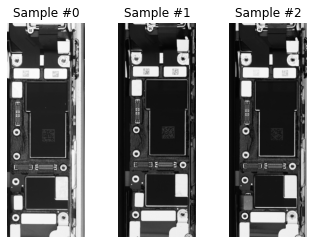

In [8]:
print('transformed images')
for i in range(3):
    sample = transformed_train_dataset[i]

    print(i, sample['image'].shape, sample['label'].shape)

    ax = plt.subplot(1, 4, i + 1)
    plt.tight_layout()
    ax.set_title('Sample #{}'.format(i))
    ax.axis('off')
    plt.imshow(np.transpose(np.asarray(sample['image'].squeeze()),(1,2,0)))

In [9]:
def prepare_data_loader(dataset, batch_size, shuffle=False):
    data_loader = DataLoader(dataset,
                          batch_size=batch_size,
                          shuffle=shuffle)
    return data_loader

In [10]:
print(len(transformed_train_dataset))
print(len(transformed_val_dataset))
train_indices = [i for i in range(2400)]
val_indices = [i for i in range(360)]
from torch.utils.data.sampler import SubsetRandomSampler
subset_transformed_train_loader = DataLoader(transformed_train_dataset,
                                       batch_size = 8, sampler=SubsetRandomSampler(train_indices))
subset_transformed_val_loader = DataLoader(transformed_train_dataset,
                                       batch_size = 8, sampler=SubsetRandomSampler(val_indices))

14314
2143


In [11]:
batch_size = 8

In [12]:
transformed_train_loader = prepare_data_loader(transformed_train_dataset, batch_size)
transformed_val_loader = prepare_data_loader(transformed_val_dataset, batch_size)
transformed_test_loader = prepare_data_loader(transformed_test_dataset, batch_size)
transformed_downsampled_train_loader = prepare_data_loader(transformed_downsampled_train_dataset, batch_size)
transformed_downsampled_val_loader = prepare_data_loader(transformed_downsampled_val_dataset, batch_size)

In [13]:
len(transformed_downsampled_train_loader)

3

In [14]:
for idx, batch in enumerate(transformed_downsampled_train_loader):
    print(batch['label'])
    

tensor([0, 0, 1, 0, 1, 0, 0, 0])
tensor([0, 0, 0, 1, 1, 1, 1, 1])
tensor([1, 0, 1, 0, 1, 0, 0, 0])


In [201]:
#torch.sum(batch['label']).item()

## AutoEncoder

In [4]:
def conv_output_shape(h_w, kernel_size=1, stride=1, pad=0, dilation=1):
    """
    Utility function for computing output of convolutions
    takes a tuple of (h,w) and returns a tuple of (h,w)
    """
    
    if type(h_w) is not tuple:
        h_w = (h_w, h_w)
    
    if type(kernel_size) is not tuple:
        kernel_size = (kernel_size, kernel_size)
    
    if type(stride) is not tuple:
        stride = (stride, stride)
    
    if type(pad) is not tuple:
        pad = (pad, pad)
    
    h = (h_w[0] + (2 * pad[0]) - (dilation * (kernel_size[0] - 1)) - 1)// stride[0] + 1
    w = (h_w[1] + (2 * pad[1]) - (dilation * (kernel_size[1] - 1)) - 1)// stride[1] + 1
    
    return h, w

def convtransp_output_shape(h_w, kernel_size=1, stride=1, pad=0, dilation=1):
    """
    Utility function for computing output of transposed convolutions
    takes a tuple of (h,w) and returns a tuple of (h,w)
    """
    
    if type(h_w) is not tuple:
        h_w = (h_w, h_w)
    
    if type(kernel_size) is not tuple:
        kernel_size = (kernel_size, kernel_size)
    
    if type(stride) is not tuple:
        stride = (stride, stride)
    
    if type(pad) is not tuple:
        pad = (pad, pad)
        
    h = (h_w[0] - 1) * stride[0] - 2 * pad[0] + kernel_size[0] + pad[0]
    w = (h_w[1] - 1) * stride[1] - 2 * pad[1] + kernel_size[1] + pad[1]
    
    return h, w

In [15]:
class Conv(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride=1, padding=0):
        super(Conv, self).__init__()
        
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

    def forward(self, x):
        return self.conv(x)
    
class ConvTranspose(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride=1, padding=0):
        super(ConvTranspose, self).__init__()
        
        self.conv = nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),
            nn.BatchNorm2d(out_channels), #produces images from 0 and + inf
            nn.LeakyReLU()
        )

    def forward(self, x):
        return self.conv(x)
    

class Encoder(nn.Module):
    '''
    Return a latent space vector (z) of size: batch_size * 1024 * 1 * 1
    '''
    def __init__(self):
        super(Encoder, self).__init__()
        
        resnet18 = models.resnet18(pretrained=True)
        for param in resnet18.parameters():
            param.requires_grad = False
        #self.encoder = nn.Sequential(*list(resnet18.children())[:-2])
        self.encoder = nn.Sequential(*list(resnet18.children())[:-1])
        self.cov1 = Conv(512, 256, 8)
        self.cov2 = Conv(256, 128, 1)
        self.cov3 = nn.Conv2d(2048, 512, 1)
        self.sigmoid = nn.Sigmoid()
        self.dropout = nn.Dropout(0.2)
        
    def forward(self, x):
        x = self.encoder(x)
        x = self.dropout(x)
        print(x.shape)
#         x = self.cov1(x)
#         print(x.shape)
#         x = self.cov2(x)
#         print(x.shape)
#         x = x.view(-1, 2048, 1, 1)
#         print(x.shape)
#         x = self.cov3(x)
#         print(x.shape)
#         x = self.sigmoid(x)
        
        return x

In [11]:
x = torch.FloatTensor(8, 3, 708, 256)
#x = x.to(device)

encoder = Encoder()
z = encoder(x)

torch.Size([8, 512, 1, 1])


In [113]:
z.shape

torch.Size([8, 512, 1, 1])

In [22]:
class Decoder(nn.Module):
    '''
    Return an image of size: batch_size * 3 * 708 * 256
    8 * 708 / 256. = 22.125, try to get kernel size of (20, 8)
    '''
    def __init__(self):
        super(Decoder, self).__init__()
        self.cov_t1 = ConvTranspose(512, 128, (20, 8), 1, 0)
        self.cov_t2 = ConvTranspose(128, 32, (20, 8), 8, 0)
        self.cov_t3 = nn.ConvTranspose2d(32,  3,  (20, 8), 4, 0)
        #images should be from 0 and 1 from the original image
        self.upsample = nn.Upsample((708,256), mode='bilinear')
        
    def forward(self, x):
        x = self.cov_t1(x)
        print(x.shape)
        x = self.cov_t2(x)
        print(x.shape)
        x = self.cov_t3(x)
        print(x.shape)
        x = self.upsample(x)
        print(x.shape)

        return nn.Sigmoid(x)

In [20]:
decoder = Decoder()

In [21]:
dec_x = decoder(z)

torch.Size([8, 128, 20, 8])
torch.Size([8, 32, 172, 64])
torch.Size([8, 3, 704, 260])
torch.Size([8, 3, 708, 256])


In [18]:
class AutoEncoder(nn.Module):
    '''
    Return an image of size: batch_size * 3 * 708 * 256
    8 * 708 / 256. = 22.125, try to get kernel size of (20, 8)
    '''
    def __init__(self):
        super(AutoEncoder, self).__init__()
        self.encoder = Encoder()
        self.decoder = Decoder()
        
    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)

        return x

In [19]:
import random
def plot(real_batch, reconstruction_batch, num_images=2):
    fig, ax = plt.subplots(num_images, 2, figsize=(10,20))
    j = [random.randrange(8) for i in range(num_images)]

    for fig_i, i in enumerate(j):
        image = real_batch[i]
        recon = reconstruction_batch[i]

        ax[fig_i, 0].imshow(np.transpose(np.asarray(image.cpu().squeeze()),(1,2,0)))
        ax[fig_i, 1].imshow(np.transpose(np.asarray(recon.cpu().detach().numpy().squeeze()),(1,2,0)))
    plt.show()

In [20]:
class Classifier(nn.Module):
    '''
    Return a logit of batch_size * 2
    '''
    def __init__(self):
        super(Classifier, self).__init__()
        self.main = nn.Sequential(
            nn.Linear(512, 64),
            nn.ReLU(),
            nn.Linear(64, 1)
        )
        
    def forward(self, x):
        x = x.view(-1, 512)
        x = self.main(x)

        return x

## Check the functional code

- Make sure the loss for classification is on the same scale with BCEloss
- Apply logits to the classification output to get probability https://stackoverflow.com/questions/62045186/using-softmax-activation-function-after-calculating-loss-from-bcewithlogitloss


In [21]:
encoder = Encoder()
decoder = Decoder()
autoencoder = AutoEncoder()
optimizer = optim.Adam(autoencoder.parameters(), lr=0.01)

In [22]:
# checkpoint = '../models/20201112_autoencoder/tune0.001_whole_labeled_checkpoint_1_1257.pth'
checkpoint = '../models/autoencoder/20210301/_checkpoint_2_1500.pth'

In [23]:
pt = torch.load(checkpoint)
autoencoder.load_state_dict(pt['best_weight'])
optimizer.load_state_dict(pt['best_optimizer'])
best_loss = pt['best_loss']

In [24]:
encoder.load_state_dict(autoencoder.encoder.state_dict())
decoder.load_state_dict(autoencoder.decoder.state_dict())

encoder.eval()
decoder.eval()
autoencoder.eval()

AutoEncoder(
  (encoder): Encoder(
    (encoder): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inplace=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
        (1): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1

In [25]:
data = next(iter(transformed_test_loader))
images = data['image']
labels = data['label']

In [26]:
recon = autoencoder(images)
z = encoder(images)

/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


In [28]:
#z

In [27]:
ae_criterion = torch.nn.MSELoss()
classification_loss = nn.BCEWithLogitsLoss()

In [28]:
ae_criterion(recon, images)

tensor(0.0086, grad_fn=<MseLossBackward>)

In [32]:
#plot(images, recon)

In [29]:
classifier = Classifier()

In [30]:
logits = classifier(z)

In [83]:
# labels.unsqueeze(1).float()

In [32]:
logits

tensor([[0.4099],
        [0.4077],
        [0.3282],
        [0.4316],
        [0.4281],
        [0.3928],
        [0.4072],
        [0.2744]], grad_fn=<AddmmBackward>)

In [33]:
classification_loss(logits, labels.unsqueeze(1).float())

tensor(0.7531, grad_fn=<BinaryCrossEntropyWithLogitsBackward>)

In [53]:
torch.sigmoid(logits)

tensor([[0.6011],
        [0.6005],
        [0.5813],
        [0.6062],
        [0.6054],
        [0.5970],
        [0.6004],
        [0.5682]], grad_fn=<SigmoidBackward>)

## Train And Evaluation

## Note:

- after training encoder and decoder for 3 epochs, cancel the autoencoder loss
- just optimize classification loss

In [90]:
def train_eval_model(encoder,
                     decoder,
                     classifier,
                     classification_loss_fn,
                     autoencoder_loss_fn,
                     encoder_optimizer,
                     decoder_optimizer,
                     classifier_optimizer,
                     train_loader,
                     val_loader,
                     to_save,
                     checkpoint, num_epochs = 10, verbose = True, alpha=10, beta=1, evaluation=True):
    if checkpoint:
        pt = torch.load(checkpoint)
        encoder.load_state_dict(pt['encoder'])
        decoder.load_state_dict(pt['decoder'])
        classifier.load_state_dict(pt['classifier'])
        encoder_optimizer.load_state_dict(pt['encoder_optimizer'])
        decoder_optimizer.load_state_dict(pt['decoder_optimizer'])
        classifier_optimizer.load_state_dict(pt['classifier_optimizer'])
        best_loss = pt['best_loss']
        best_partial_auc = pt['best_partial_auc']
    else:
        encoder_weight = copy.deepcopy(encoder.state_dict())
        decoder_weight = copy.deepcopy(decoder.state_dict())
        classifier_weight = copy.deepcopy(classifier.state_dict())
        best_loss = np.inf

        best_partial_auc = 0
        
    print('best_partial_auc', best_partial_auc)
        
    train_loss = []
    val_loss = []
        
    start_time = time.time()
    acc_dict = {'train':[],'validation':[]}
    loss_dict = {'train':[],'validation':[]}
    partial_auc_dict ={'train': [], 'validation': []}
    
    for epoch in range(num_epochs):
        epoch_start_time = time.time()
        if verbose:
            if epoch % 1 == 0:
                print('-' * 10)
                print('Epoch {}/{}'.format(epoch+1, num_epochs))
                print('-' * 10)
            
        encoder.train(True)
        decoder.train(True)
        classifier.train(True)

        train_running_loss = 0.0
        train_truths = []
        train_scores = []

        for batch_idx, data in enumerate(train_loader):
            # FINISH EVALUATION, BRING MODE BACK TO TRAIN
            encoder.train(True)
            decoder.train(True)
            classifier.train(True)
            
            if batch_idx % 200 == 0:
                print('train batch {} / {}'.format(batch_idx, len(train_loader)))

            images = data['image']
            labels = data['label']

            images = images.to(device)
            labels = labels.to(device)
            
            ############################
            # (1) Update Autoencoder network: 
            ###########################

            decoder_optimizer.zero_grad()
            encoder_optimizer.zero_grad()

            # Train autoencoder
            z = encoder(images)
            z = z.to(device)
            reconstruction = decoder(z).to(device)

            autoencoder_loss = autoencoder_loss_fn(reconstruction, images)

            # Train classifier if it is labeled data
            
            ############################
            # (2) Update Classifier 
            ###########################
            if torch.sum(labels).item() >= 0:
                classifier_optimizer.zero_grad()
                
                classification_output = classifier(z)
                classification_loss = classification_loss_fn(classification_output, labels.unsqueeze(1).float())


                _, preds = torch.max(classification_output, dim=1)
                score = torch.sigmoid(classification_output)
#                 score = classification_output

                train_truths += list(labels.cpu().numpy())
                train_scores += [i.tolist() for i in score]


            # Rescale the autoencoder loss loss
            if torch.sum(labels).item() >= 0:
                minibatch_loss = alpha * autoencoder_loss + beta * classification_loss
            # we want to focus on optimizing the classification loss, so we do not backward minibatch_loss
            else:
                minibatch_loss = alpha * autoencoder_loss
                
            if batch_idx % 100 == 0:
                print('-' * 10)
                print('train_batch_idx {}'.format(batch_idx))
                print('train: autoencoder loss {}, classification loss {}, minibatch_loss {}'.format(autoencoder_loss,
                                                                                                     classification_loss,
                                                                                                      minibatch_loss))
                
                plot(images, reconstruction)

            # Calculate gradients for minibatch 
            minibatch_loss.backward(retain_graph=True)
            # Update encoder
            encoder_optimizer.step()
            # Update classifier
            classifier_optimizer.step()
            # Update decoder
            decoder_optimizer.step()
            
            # Update loss
            train_running_loss += minibatch_loss.item()

            # Evaluate
            if evaluation and batch_idx % 300 == 0:
                encoder.eval()
                decoder.eval()
                classifier.eval()
                
                val_running_loss = 0.0
                val_truths = []
                val_scores = []

                for val_batch_idx, data in enumerate(val_loader):
                    if val_batch_idx % 500 == 0:
                        print('-' * 10)
                        print('val batch {} / {}'.format(val_batch_idx, len(val_loader)))
                        print('val: autoencoder loss {}, classification loss {}, minibatch_loss {}'.format(autoencoder_loss,
                                                                                                      classification_loss,
                                                                                                      minibatch_loss))

                    images = data['image']
                    labels = data['label']

                    images = images.to(device)
                    labels = labels.to(device)

                    with torch.no_grad():
                        z = encoder(images)
                        z = z.to(device)
                        reconstruction = decoder(z).to(device)

                        autoencoder_loss = autoencoder_loss_fn(reconstruction, images)

                    if torch.sum(labels).item() >= 0:
                        with torch.no_grad():
                            classification_output = classifier(z)
                        classification_loss = classification_loss_fn(classification_output,
                                                                     labels.unsqueeze(1).float())
                        score = torch.sigmoid(classification_output)
#                         score = classification_output

                        val_truths += list(labels.cpu().numpy())
                        val_scores += [i.tolist() for i in score]    

                    if torch.sum(labels).item() >= 0:
                        minibatch_loss = alpha * autoencoder_loss + beta * classification_loss
                    else:
                        minibatch_loss = alpha * autoencoder_loss


                    val_running_loss += minibatch_loss.item()

#                     if val_batch_idx % 400 == 0:
#                         plot(images, reconstruction)

                epoch_loss = val_running_loss / len(val_loader)
                epoch_scores = np.array(val_scores)
#                 print('epoch_scores_shape', epoch_scores.shape)
#                 epoch_partial_auc = roc_auc_score(val_truths, epoch_scores[:, 1], max_fpr=0.05)
                epoch_partial_auc = roc_auc_score(val_truths, epoch_scores, max_fpr=0.05)
                print('-' * 10)
                print('val_epoch_loss {}'.format(epoch_loss))
                print('val_epoch_partial_auc {}'.format(epoch_partial_auc))
                print('val_score {}'.format(epoch_scores))

                val_loss.append(epoch_loss)
                
                if best_partial_auc < epoch_partial_auc:
                    best_loss = epoch_loss
                    best_partial_auc = epoch_partial_auc
                    print('-' * 10)
                    print('saving weights')

                    best_encoder_wts = copy.deepcopy(encoder.state_dict())
                    best_decoder_wts = copy.deepcopy(decoder.state_dict())
                    best_classifier_model_wts = copy.deepcopy(classifier.state_dict())
                    checkpoint = {'encoder':best_encoder_wts,
                                  'decoder': best_decoder_wts,
                              'classifier': best_classifier_model_wts,
                              'encoder_optimizer': encoder_optimizer.state_dict(),
                              'decoder_optimizer': decoder_optimizer.state_dict(),
                              'classifier_optimizer': classifier_optimizer.state_dict(),
                              'best_loss': best_loss,
                              'best_partial_auc': best_partial_auc,
                              'truths': val_truths,
                              'scores': epoch_scores
                             }
                    
                    torch.save(checkpoint, to_save + '_{}_{}.pth'.format(epoch, batch_idx))

                
        train_epoch_loss = train_running_loss / len(train_loader)
        epoch_scores = np.array(train_scores)
        epoch_partial_auc = roc_auc_score(train_truths, epoch_scores, max_fpr=0.05)
        print('train_epoch_loss {} train_epoch_partial_auc {}'.format(epoch_loss, epoch_partial_auc))
        train_loss.append(epoch_loss)
        
        if not evaluation and epoch_partial_auc > best_partial_auc:
            best_loss = epoch_loss
            best_partial_auc = epoch_partial_auc
            print('saving weights')

            best_encoder_wts = copy.deepcopy(encoder.state_dict())
            best_decoder_wts = copy.deepcopy(decoder.state_dict())
            best_classifier_model_wts = copy.deepcopy(classifier.state_dict())
            checkpoint = {'encoder':best_encoder_wts,
                          'decoder': best_decoder_wts,
                          'classifier': best_classifier_model_wts,
                          'encoder_optimizer': encoder_optimizer.state_dict(),
                          'decoder_optimizer': decoder_optimizer.state_dict(),
                          'classifier_optimizer': classifier_optimizer.state_dict(),
                          'best_loss': best_loss,
                          'best_partial_auc': best_partial_auc,
                          'truths': train_truths,
                          'scores': epoch_scores
                         }

            torch.save(checkpoint, to_save + '_{}_{}.pth'.format(epoch, batch_idx))
                
                
    return encoder, decoder, classifier

## Train AutoEncoder and Classifier

In [97]:
encoder = Encoder().to(device)
decoder = Decoder().to(device)
classifier = Classifier().to(device)
autoencoder = AutoEncoder()


In [98]:
#encoder

In [99]:
# This checkpoint has only autoencoder weight
checkpoint = '../models/autoencoder/20210301/_checkpoint_2_1500.pth'
pt = torch.load(checkpoint)
autoencoder.load_state_dict(pt['best_weight'])
best_loss = pt['best_loss']
ae_optimizer = optim.Adam(autoencoder.parameters(), lr=0.005)
ae_optimizer.load_state_dict(pt['best_optimizer'])
encoder.load_state_dict(autoencoder.encoder.state_dict())
decoder.load_state_dict(autoencoder.decoder.state_dict())

<All keys matched successfully>

In [100]:
pt['best_loss']

0.008786893093937568

In [101]:
# # This checkpoint has encoder, decoder, classifier weight
# checkpoint = '../models/20201112_autoencoder_classifier_simul/alpha10_9_0.pth'
# pt = torch.load(checkpoint)
# encoder.load_state_dict(pt['encoder'])
# decoder.load_state_dict(pt['decoder'])
# classifier.load_state_dict(pt['classifier'])

In [102]:
for param in encoder.parameters():
    param.requires_grad = True
    
for param in decoder.parameters():
    param.requires_grad = True
    
for param in classifier.parameters():
    param.requires_grad = True
    
    
# autoencoder_criterion = torch.nn.BCEWithLogitsLoss()
# classification_criterion = nn.CrossEntropyLoss(reduction='sum')
autoencoder_criterion = torch.nn.MSELoss()
classification_criterion = nn.BCEWithLogitsLoss()

# NOTE: 
# When we do checkpoint, we cant reinitiate the encoder optimizer

encoder_optimizer = optim.Adam(encoder.parameters(), lr=0.01)
decoder_optimizer = optim.Adam(decoder.parameters(), lr=0.01)
classifier_optimizer = optim.Adam(classifier.parameters(), lr=0.01)

In [103]:
downsampled_dataloader = {'train': transformed_downsampled_train_loader,
                          'val': transformed_downsampled_train_loader}
dataloader = {'train': transformed_train_loader,
              'val': transformed_val_loader}

In [63]:
device

device(type='cuda', index=0)

best_partial_auc 0
----------
Epoch 1/10
----------
train batch 0 / 3
----------
train_batch_idx 0
train: autoencoder loss 0.007848678156733513, classification loss 0.6251787543296814, minibatch_loss 0.703665554523468


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


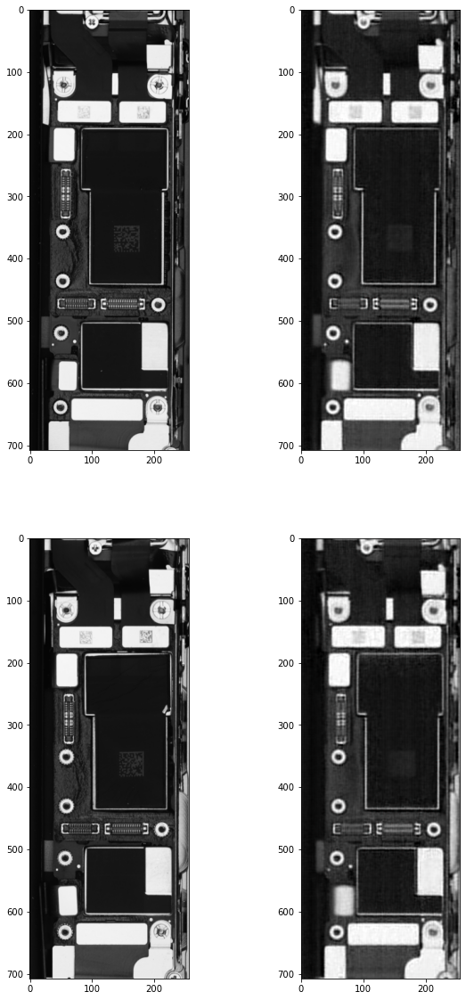

----------
val batch 0 / 3
val: autoencoder loss 0.007848678156733513, classification loss 0.6251787543296814, minibatch_loss 0.703665554523468
----------
val_epoch_loss 0.7199774583180746
val_epoch_partial_auc 0.5384615384615384
val_score [[0.40799019]
 [0.34110343]
 [0.54263902]
 [0.44059557]
 [0.42274451]
 [0.32158178]
 [0.36755335]
 [0.44438511]
 [0.34795356]
 [0.36746716]
 [0.18979242]
 [0.43158606]
 [0.45994544]
 [0.35890606]
 [0.46145183]
 [0.30131996]
 [0.55366892]
 [0.12435603]
 [0.35044178]
 [0.16925843]
 [0.26684031]
 [0.32724524]
 [0.18964334]
 [0.54485899]]
----------
saving weights


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train_epoch_loss 0.7199774583180746 train_epoch_partial_auc 0.5897435897435898
----------
Epoch 2/10
----------
train batch 0 / 3
----------
train_batch_idx 0
train: autoencoder loss 0.007090416736900806, classification loss 0.5618368983268738, minibatch_loss 0.6327410936355591


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


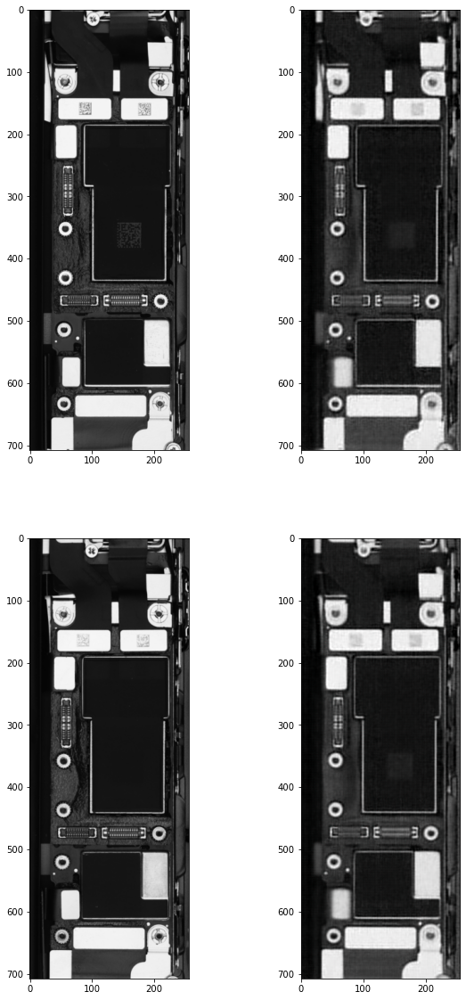

----------
val batch 0 / 3
val: autoencoder loss 0.007090416736900806, classification loss 0.5618368983268738, minibatch_loss 0.6327410936355591
----------
val_epoch_loss 0.6802579164505005
val_epoch_partial_auc 0.5384615384615384
val_score [[0.43128404]
 [0.34908655]
 [0.5396753 ]
 [0.43405437]
 [0.45033368]
 [0.31583363]
 [0.36318761]
 [0.43757045]
 [0.32572019]
 [0.35459581]
 [0.17216875]
 [0.43939483]
 [0.47827888]
 [0.3946079 ]
 [0.52735603]
 [0.33077386]
 [0.55797243]
 [0.11520807]
 [0.40445536]
 [0.16290541]
 [0.28294119]
 [0.31180727]
 [0.17928156]
 [0.54205257]]


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train_epoch_loss 0.6802579164505005 train_epoch_partial_auc 0.5897435897435898
----------
Epoch 3/10
----------
train batch 0 / 3
----------
train_batch_idx 0
train: autoencoder loss 0.006908515468239784, classification loss 0.5414937734603882, minibatch_loss 0.6105788946151733

/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


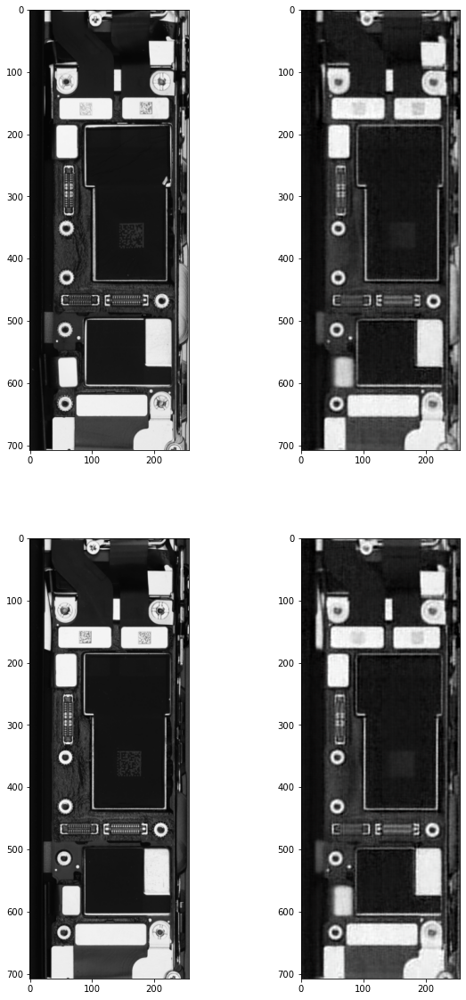

----------
val batch 0 / 3
val: autoencoder loss 0.006908515468239784, classification loss 0.5414937734603882, minibatch_loss 0.6105788946151733
----------
val_epoch_loss 0.6522529522577921
val_epoch_partial_auc 0.5384615384615384
val_score [[0.4432283 ]
 [0.34266266]
 [0.55595773]
 [0.44002092]
 [0.47261021]
 [0.28947762]
 [0.36879966]
 [0.44400275]
 [0.32036328]
 [0.35352379]
 [0.15730336]
 [0.43190786]
 [0.50347179]
 [0.41807941]
 [0.55356175]
 [0.36037111]
 [0.56950647]
 [0.10389663]
 [0.44282445]
 [0.15347861]
 [0.30785495]
 [0.30488235]
 [0.16740611]
 [0.55619085]]


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train_epoch_loss 0.6522529522577921 train_epoch_partial_auc 0.5384615384615384
----------
Epoch 4/10
----------
train batch 0 / 3


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


----------
train_batch_idx 0
train: autoencoder loss 0.006957085337489843, classification loss 0.5267386436462402, minibatch_loss 0.5963094830513


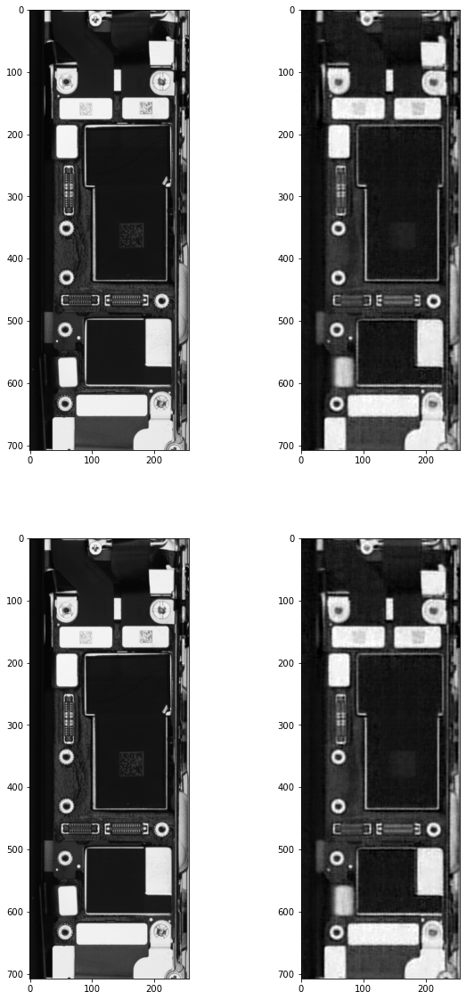

----------
val batch 0 / 3
val: autoencoder loss 0.006957085337489843, classification loss 0.5267386436462402, minibatch_loss 0.5963094830513
----------
val_epoch_loss 0.6283838351567587
val_epoch_partial_auc 0.641025641025641
val_score [[0.45670438]
 [0.34719628]
 [0.57075745]
 [0.41690612]
 [0.50119811]
 [0.26194432]
 [0.35475567]
 [0.44592327]
 [0.32323861]
 [0.34495929]
 [0.13179173]
 [0.42482159]
 [0.51964545]
 [0.42633021]
 [0.57075745]
 [0.36347526]
 [0.57075745]
 [0.08645367]
 [0.46913633]
 [0.13262045]
 [0.31960943]
 [0.28583059]
 [0.14927153]
 [0.54085648]]
----------
saving weights


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train_epoch_loss 0.6283838351567587 train_epoch_partial_auc 0.641025641025641
----------
Epoch 5/10
----------
train batch 0 / 3
----------
train_batch_idx 0


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


train: autoencoder loss 0.006853215396404266, classification loss 0.49891942739486694, minibatch_loss 0.5674515962600708


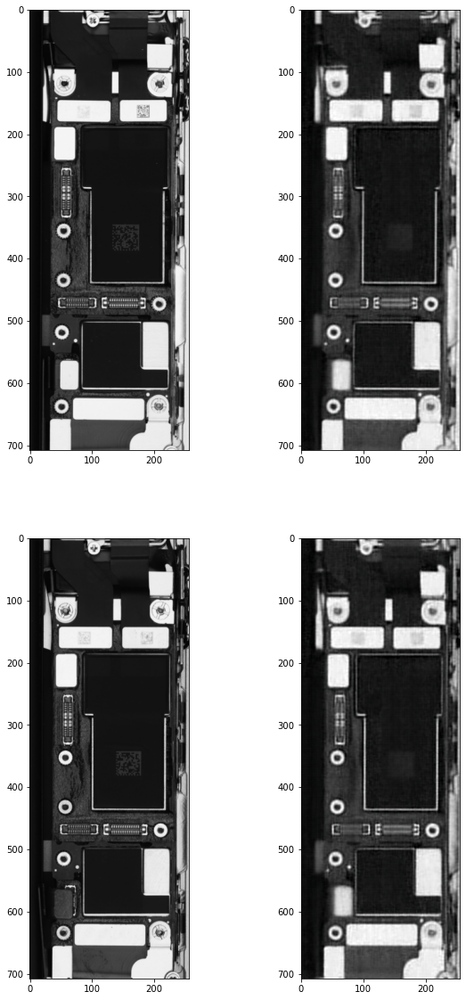

----------
val batch 0 / 3
val: autoencoder loss 0.006853215396404266, classification loss 0.49891942739486694, minibatch_loss 0.5674515962600708
----------
val_epoch_loss 0.6029172341028849
val_epoch_partial_auc 0.7435897435897436
val_score [[0.45850864]
 [0.32725701]
 [0.54545081]
 [0.38714585]
 [0.53468376]
 [0.22968572]
 [0.34284601]
 [0.43044025]
 [0.28063852]
 [0.31041417]
 [0.09539073]
 [0.4107115 ]
 [0.50316179]
 [0.4403688 ]
 [0.5721432 ]
 [0.36309698]
 [0.56977838]
 [0.06555506]
 [0.47099862]
 [0.11119594]
 [0.31805882]
 [0.23934813]
 [0.12142328]
 [0.49518991]]
----------
saving weights


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train_epoch_loss 0.6029172341028849 train_epoch_partial_auc 0.6923076923076923
----------
Epoch 6/10
----------
train batch 0 / 3
----------
train_batch_idx 0
train: autoencoder loss 0.006798282265663147, classification loss 0.47499120235443115, minibatch_loss 0.5429739952087402


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


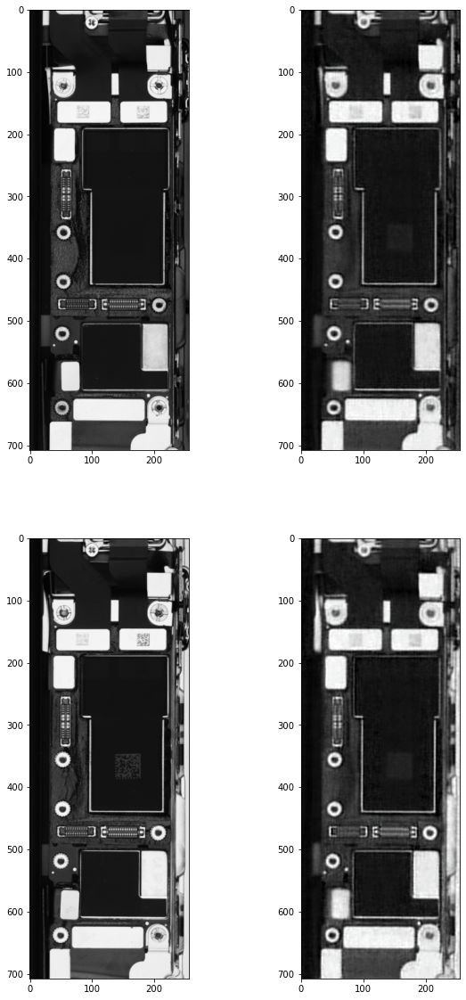

----------
val batch 0 / 3
val: autoencoder loss 0.006798282265663147, classification loss 0.47499120235443115, minibatch_loss 0.5429739952087402
----------
val_epoch_loss 0.585111141204834
val_epoch_partial_auc 0.7435897435897436
val_score [[0.42478755]
 [0.32530248]
 [0.52544975]
 [0.37704408]
 [0.56433082]
 [0.19335394]
 [0.32662672]
 [0.42383516]
 [0.24007246]
 [0.27973208]
 [0.07204123]
 [0.41002247]
 [0.50380582]
 [0.41517347]
 [0.57381696]
 [0.37465519]
 [0.5394665 ]
 [0.04895587]
 [0.48905614]
 [0.09290124]
 [0.32221431]
 [0.20746742]
 [0.09579935]
 [0.49507439]]


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train_epoch_loss 0.585111141204834 train_epoch_partial_auc 0.7435897435897436
----------
Epoch 7/10
----------
train batch 0 / 3
----------
train_batch_idx 0
train: autoencoder loss 0.006740693934261799, classification loss 0.48601233959198, minibatch_loss 0.553419291973114


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


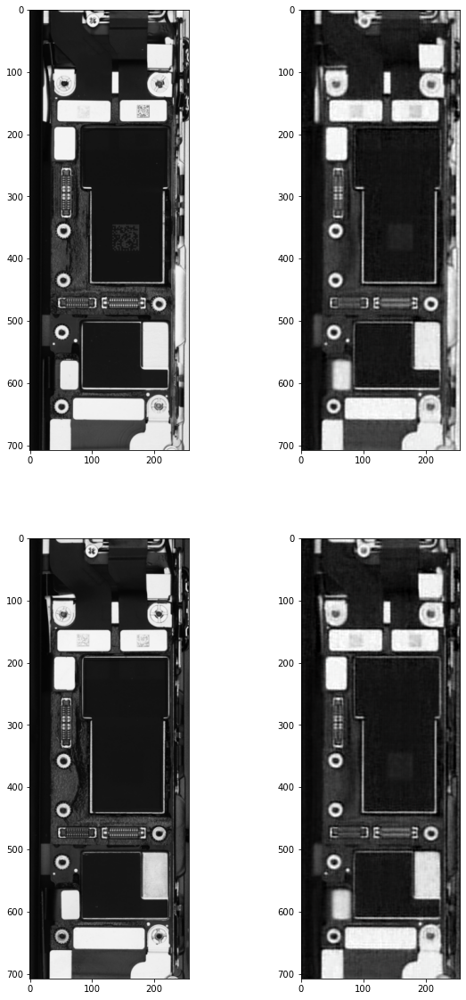

----------
val batch 0 / 3
val: autoencoder loss 0.006740693934261799, classification loss 0.48601233959198, minibatch_loss 0.553419291973114
----------
val_epoch_loss 0.5484924713770548
val_epoch_partial_auc 0.7948717948717948
val_score [[0.43324244]
 [0.3487027 ]
 [0.53447127]
 [0.39364204]
 [0.57579595]
 [0.16773084]
 [0.3272368 ]
 [0.43134204]
 [0.21244663]
 [0.25813308]
 [0.05667716]
 [0.43707368]
 [0.54880488]
 [0.49351951]
 [0.57579595]
 [0.42794698]
 [0.53723925]
 [0.03531898]
 [0.57359684]
 [0.07917025]
 [0.36991355]
 [0.17909019]
 [0.0800213 ]
 [0.51728231]]
----------
saving weights


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train_epoch_loss 0.5484924713770548 train_epoch_partial_auc 0.846153846153846
----------
Epoch 8/10
----------
train batch 0 / 3
----------
train_batch_idx 0
train: autoencoder loss 0.006539720576256514, classification loss 0.48342907428741455, minibatch_loss 0.548826277256012


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


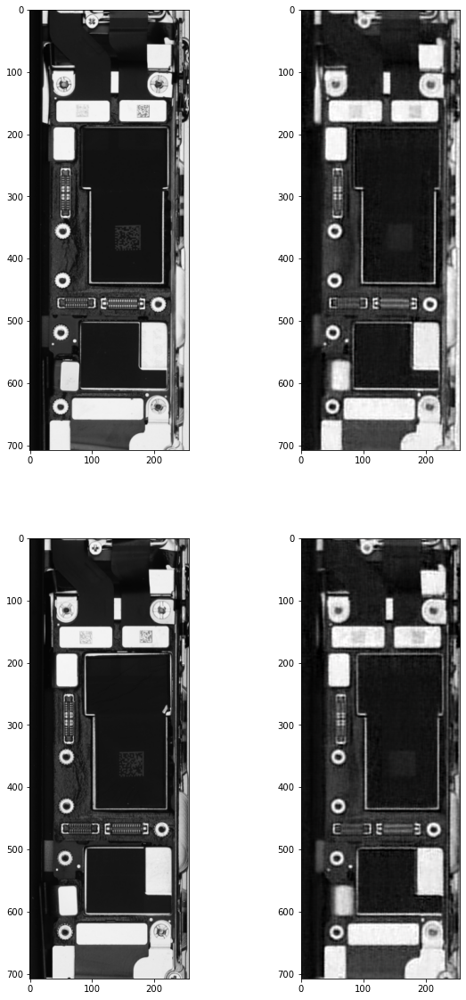

----------
val batch 0 / 3
val: autoencoder loss 0.006539720576256514, classification loss 0.48342907428741455, minibatch_loss 0.548826277256012
----------
val_epoch_loss 0.5205277502536774
val_epoch_partial_auc 0.846153846153846
val_score [[0.42637911]
 [0.35723829]
 [0.54776651]
 [0.3934727 ]
 [0.57783735]
 [0.14688137]
 [0.30944559]
 [0.43444809]
 [0.18595241]
 [0.24743037]
 [0.04212666]
 [0.44701868]
 [0.57783735]
 [0.54597664]
 [0.57783735]
 [0.46028695]
 [0.56239188]
 [0.02482321]
 [0.57783735]
 [0.06547529]
 [0.41859898]
 [0.1505972 ]
 [0.06380738]
 [0.5243625 ]]
----------
saving weights


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train_epoch_loss 0.5205277502536774 train_epoch_partial_auc 0.846153846153846
----------
Epoch 9/10
----------
train batch 0 / 3
----------
train_batch_idx 0
train: autoencoder loss 0.006422289181500673, classification loss 0.45875969529151917, minibatch_loss 0.5229825973510742


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


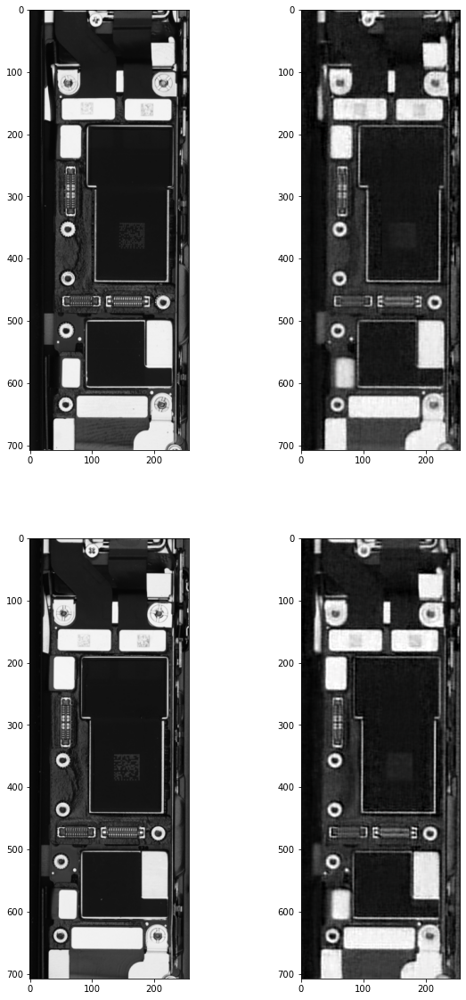

----------
val batch 0 / 3
val: autoencoder loss 0.006422289181500673, classification loss 0.45875969529151917, minibatch_loss 0.5229825973510742
----------
val_epoch_loss 0.4971584479014079
val_epoch_partial_auc 0.846153846153846
val_score [[0.40640283]
 [0.34033149]
 [0.5494476 ]
 [0.37164736]
 [0.57989901]
 [0.11846552]
 [0.27643654]
 [0.41968372]
 [0.15490223]
 [0.20090598]
 [0.02822564]
 [0.4392975 ]
 [0.57989901]
 [0.56091881]
 [0.57989901]
 [0.46559823]
 [0.57989901]
 [0.01607049]
 [0.57989901]
 [0.04603086]
 [0.43039986]
 [0.12286501]
 [0.0462505 ]
 [0.51083368]]


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train_epoch_loss 0.4971584479014079 train_epoch_partial_auc 0.846153846153846
----------
Epoch 10/10
----------
train batch 0 / 3
----------
train_batch_idx 0
train: autoencoder loss 0.006314363796263933, classification loss 0.4167258143424988, minibatch_loss 0.47986945509910583


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


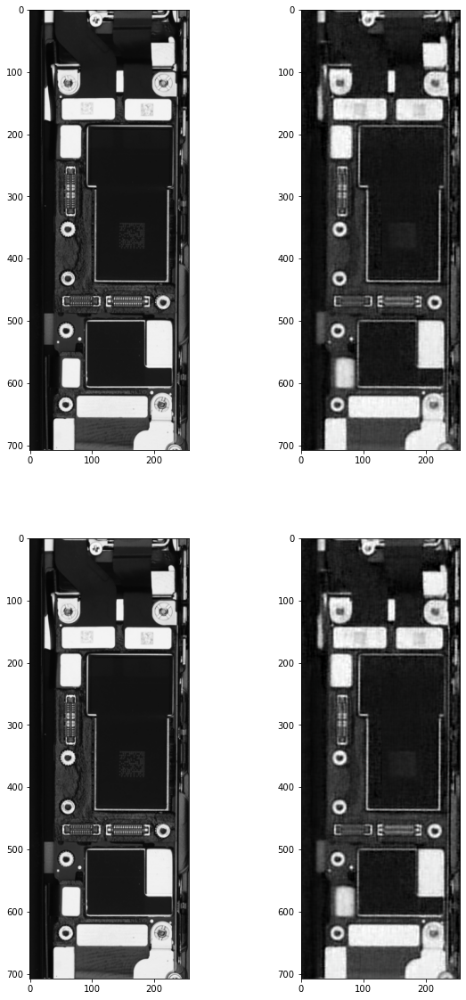

----------
val batch 0 / 3
val: autoencoder loss 0.006314363796263933, classification loss 0.4167258143424988, minibatch_loss 0.47986945509910583
----------
val_epoch_loss 0.4808195134003957
val_epoch_partial_auc 0.846153846153846
val_score [[0.37276244]
 [0.29328343]
 [0.54069287]
 [0.32406494]
 [0.58211297]
 [0.0844551 ]
 [0.2177666 ]
 [0.38020551]
 [0.11324187]
 [0.15672421]
 [0.01649869]
 [0.40042809]
 [0.53055751]
 [0.54215038]
 [0.58211297]
 [0.44561329]
 [0.58211297]
 [0.00919004]
 [0.58211297]
 [0.02871938]
 [0.4157941 ]
 [0.08920205]
 [0.02918109]
 [0.47207922]]


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train_epoch_loss 0.4808195134003957 train_epoch_partial_auc 0.846153846153846


In [96]:
encoder_t, decoder_t, classifier_t = train_eval_model(encoder=encoder,
                         decoder=decoder,
                         classifier=classifier,
                         classification_loss_fn=classification_criterion,
                         autoencoder_loss_fn=autoencoder_criterion,
                         encoder_optimizer=encoder_optimizer,
                         decoder_optimizer=decoder_optimizer,
                         classifier_optimizer=classifier_optimizer,
                         train_loader=transformed_downsampled_train_loader,
                         val_loader=transformed_downsampled_train_loader,
                         to_save='../models/simul/test',
                         checkpoint=None,
                         num_epochs=10,
                         verbose=True,
                         alpha=10,
                         beta=1,
                         evaluation=True)

In [75]:
#len(transformed_test_loader)

180

best_partial_auc 0
----------
Epoch 1/5
----------
train batch 0 / 1790
----------
train_batch_idx 0
train: autoencoder loss 0.009536624886095524, classification loss 0.6788616180419922, minibatch_loss 0.07742279022932053


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


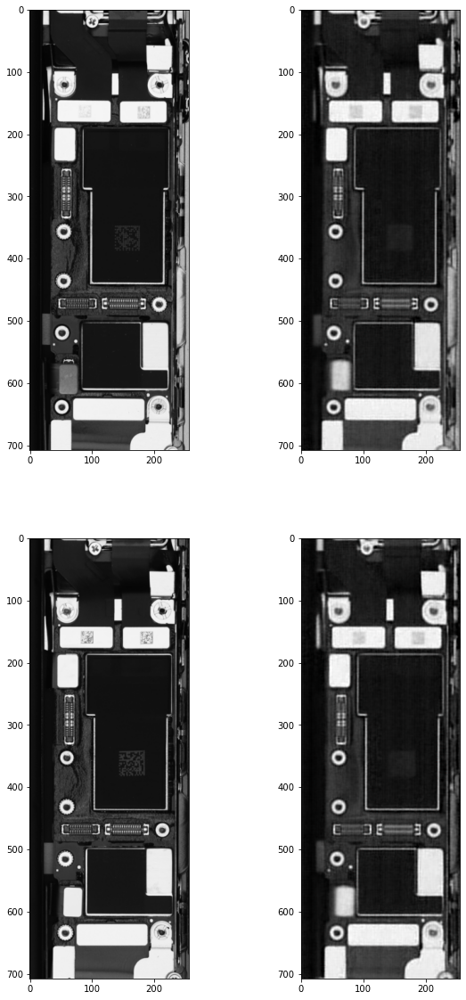

----------
val batch 0 / 268
val: autoencoder loss 0.009536624886095524, classification loss 0.6788616180419922, minibatch_loss 0.07742279022932053
----------
val_epoch_loss 0.11395190905001182
val_epoch_partial_auc 0.5283075228697733
val_score [[0.09967027]
 [0.04717283]
 [0.08972035]
 ...
 [0.10289299]
 [0.08750435]
 [0.09040899]]
----------
saving weights


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


----------
train_batch_idx 100
train: autoencoder loss 0.009154930710792542, classification loss 0.6005014777183533, minibatch_loss 0.06920507550239563


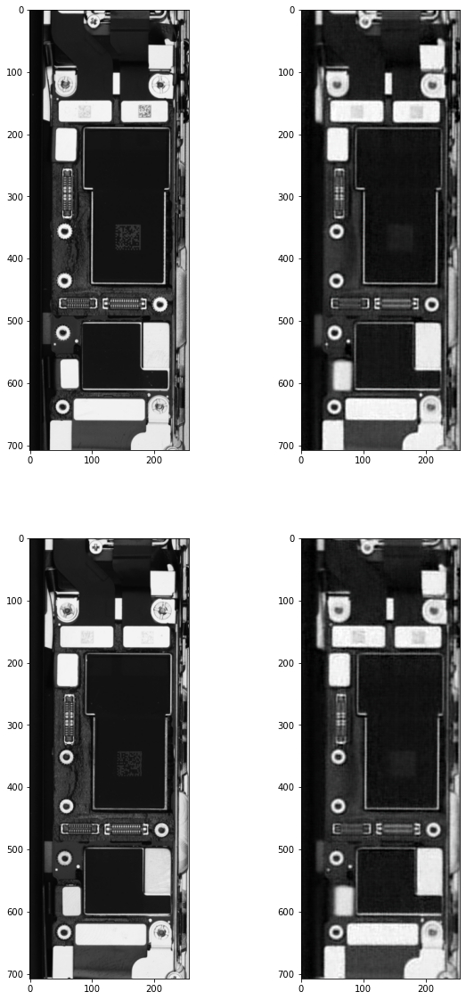

train batch 200 / 1790
----------
train_batch_idx 200
train: autoencoder loss 0.010472587309777737, classification loss 0.6837454438209534, minibatch_loss 0.07884713262319565


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


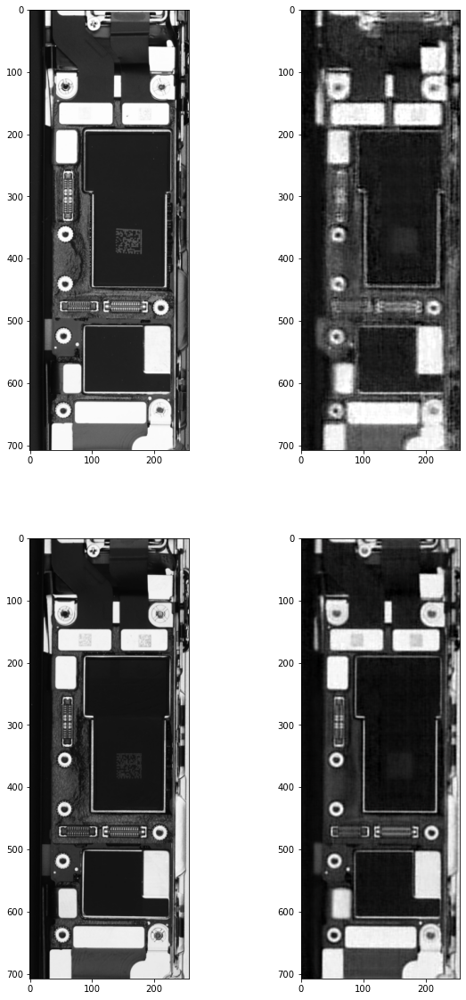

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


----------
train_batch_idx 300
train: autoencoder loss 0.00906774029135704, classification loss 0.48380494117736816, minibatch_loss 0.05744823440909386


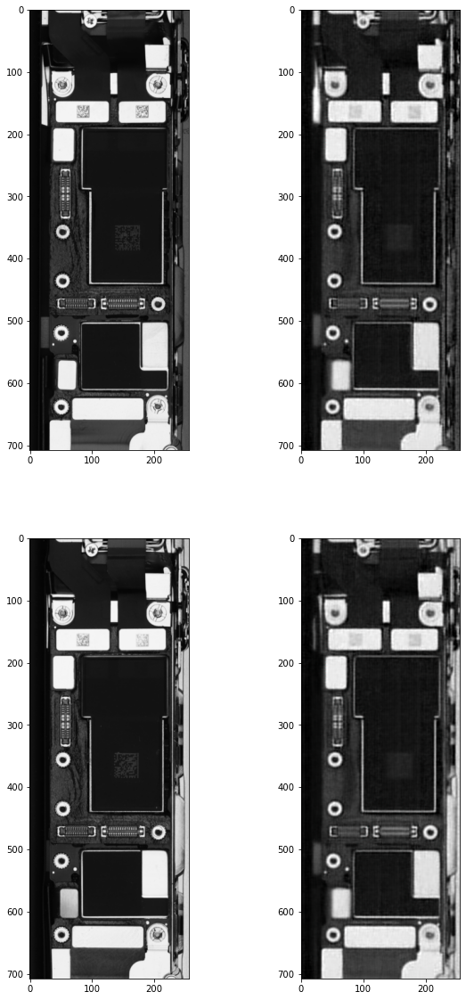

----------
val batch 0 / 268
val: autoencoder loss 0.00906774029135704, classification loss 0.48380494117736816, minibatch_loss 0.05744823440909386
----------
val_epoch_loss 0.0703999487432971
val_epoch_partial_auc 0.540385006500762
val_score [[0.57380217]
 [0.11186664]
 [0.53954893]
 ...
 [0.7325117 ]
 [0.49090454]
 [0.55902582]]
----------
saving weights


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train batch 400 / 1790
----------
train_batch_idx 400
train: autoencoder loss 0.008480018004775047, classification loss 0.5669894218444824, minibatch_loss 0.06517896056175232


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


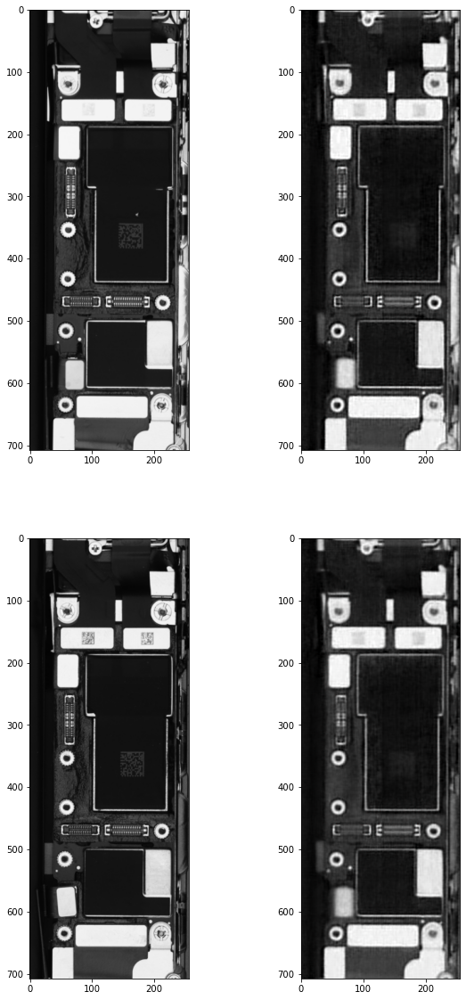

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


----------
train_batch_idx 500
train: autoencoder loss 0.011107542552053928, classification loss 0.5423433184623718, minibatch_loss 0.06534187495708466


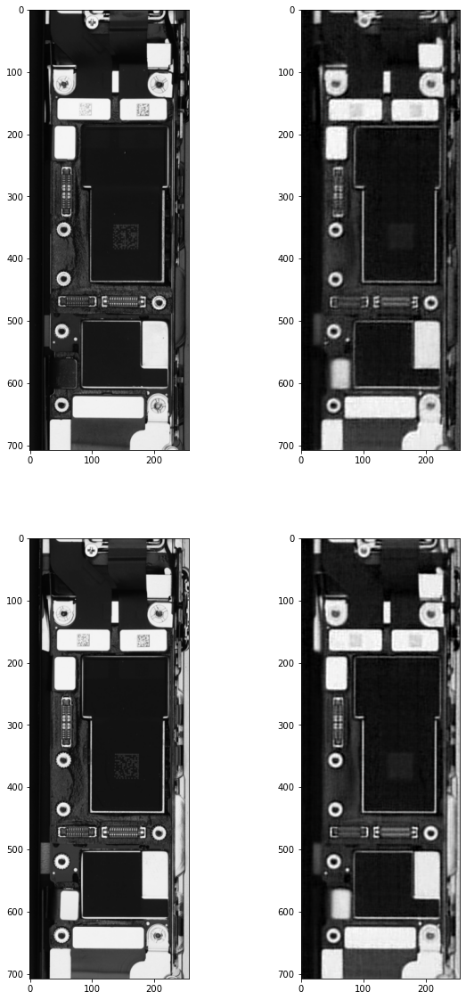

train batch 600 / 1790
----------
train_batch_idx 600
train: autoencoder loss 0.009808970615267754, classification loss 0.5262573957443237, minibatch_loss 0.062434710562229156


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


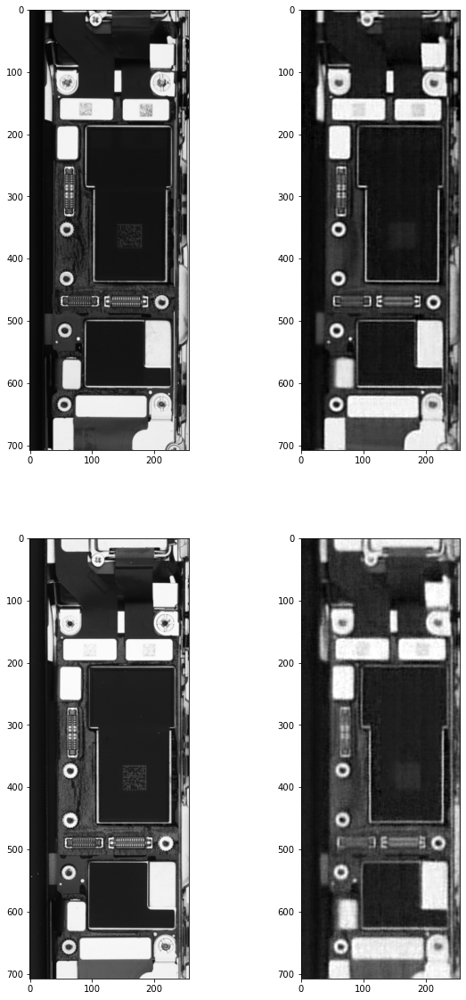

----------
val batch 0 / 268
val: autoencoder loss 0.009808970615267754, classification loss 0.5262573957443237, minibatch_loss 0.062434710562229156
----------
val_epoch_loss 0.07093348245678553
val_epoch_partial_auc 0.5327878682372966
val_score [[0.41148075]
 [0.07642626]
 [0.34220925]
 ...
 [0.52130026]
 [0.35766649]
 [0.32457188]]


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


----------
train_batch_idx 700
train: autoencoder loss 0.007793044671416283, classification loss 0.6269811987876892, minibatch_loss 0.07049116492271423


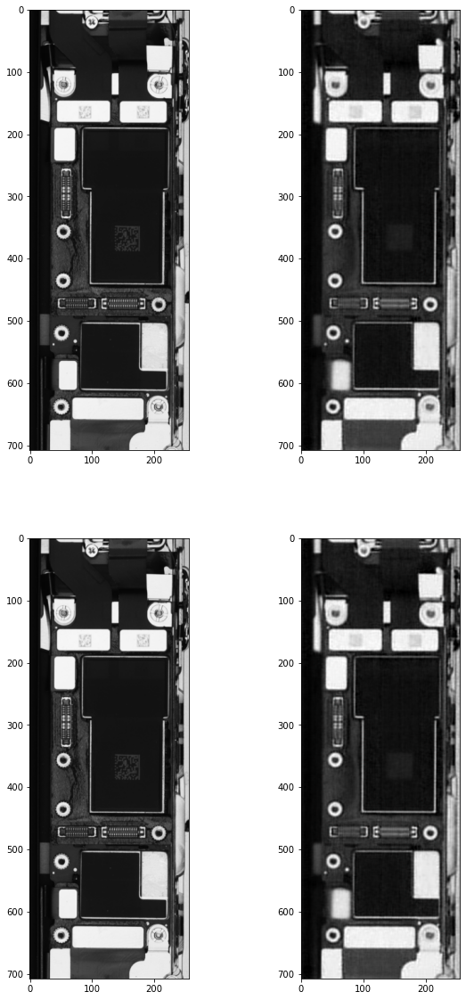

train batch 800 / 1790
----------
train_batch_idx 800
train: autoencoder loss 0.007715972140431404, classification loss 0.5736632347106934, minibatch_loss 0.06508229672908783


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


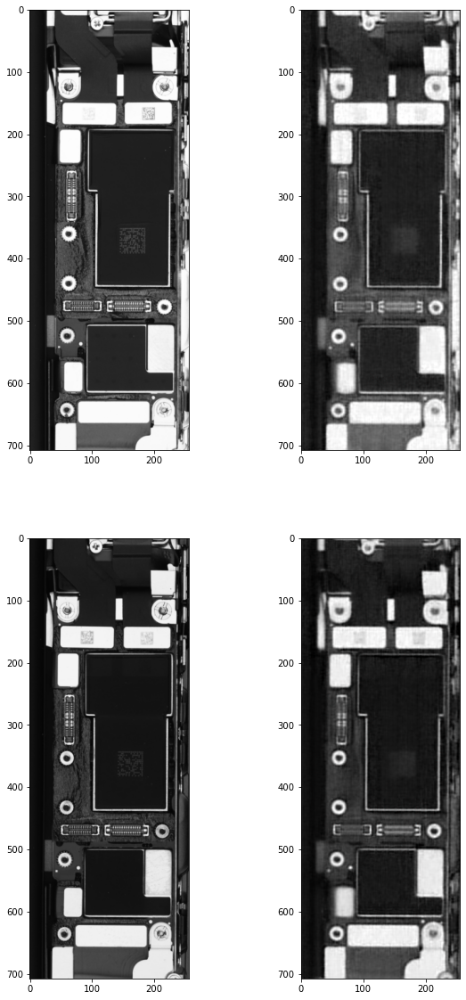

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


----------
train_batch_idx 900
train: autoencoder loss 0.008236262015998363, classification loss 0.7179982662200928, minibatch_loss 0.08003608882427216


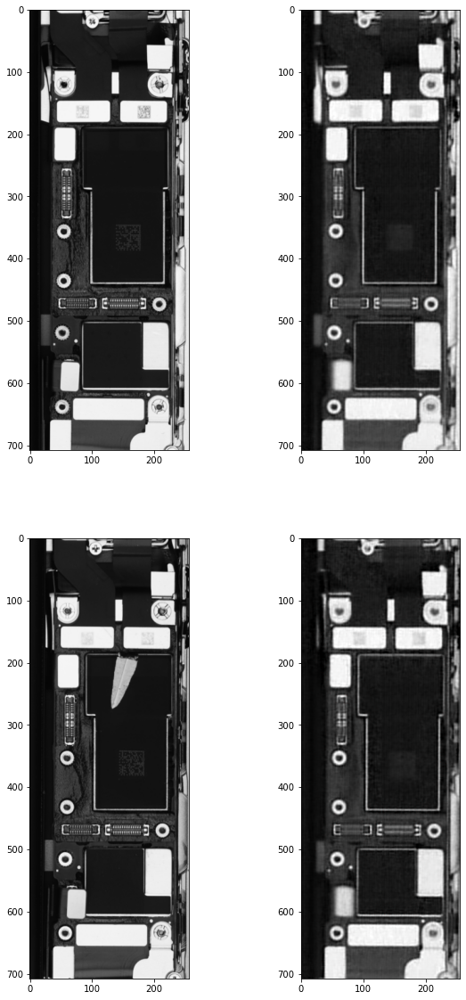

----------
val batch 0 / 268
val: autoencoder loss 0.008236262015998363, classification loss 0.7179982662200928, minibatch_loss 0.08003608882427216
----------
val_epoch_loss 0.07242625394363457
val_epoch_partial_auc 0.5058936077527886
val_score [[0.54142463]
 [0.23411824]
 [0.54142463]
 ...
 [0.54142463]
 [0.54142463]
 [0.54142463]]


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train batch 1000 / 1790
----------
train_batch_idx 1000
train: autoencoder loss 0.008085989393293858, classification loss 0.5907989144325256, minibatch_loss 0.06716588139533997


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


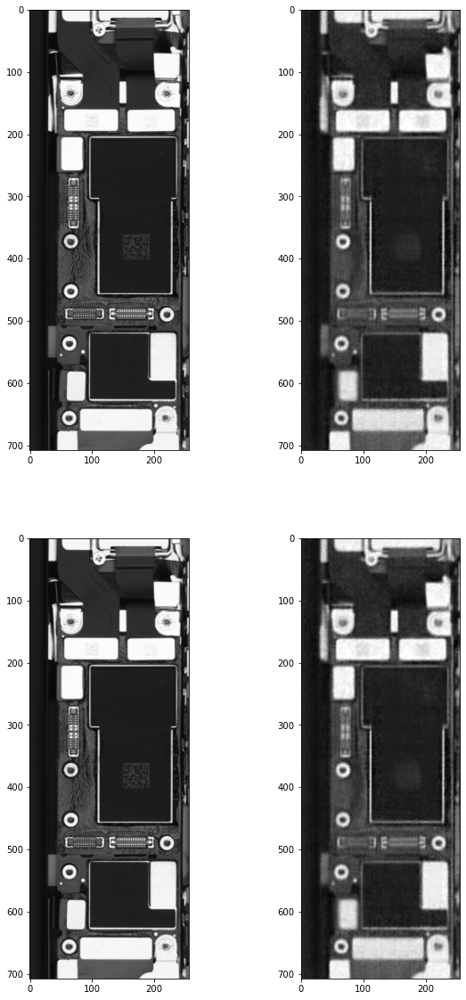

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


----------
train_batch_idx 1100
train: autoencoder loss 0.00814286433160305, classification loss 0.6372877359390259, minibatch_loss 0.07187163829803467


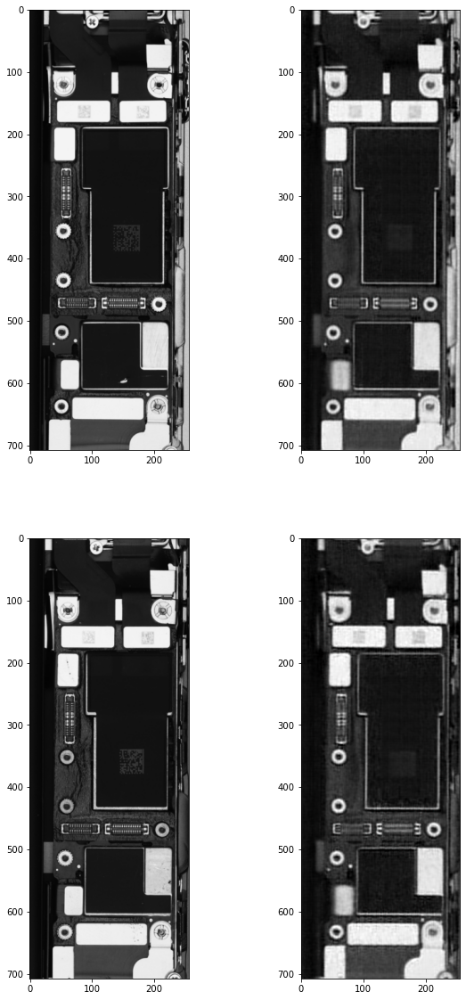

train batch 1200 / 1790
----------
train_batch_idx 1200
train: autoencoder loss 0.009812925942242146, classification loss 0.8683494329452515, minibatch_loss 0.09664787352085114


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


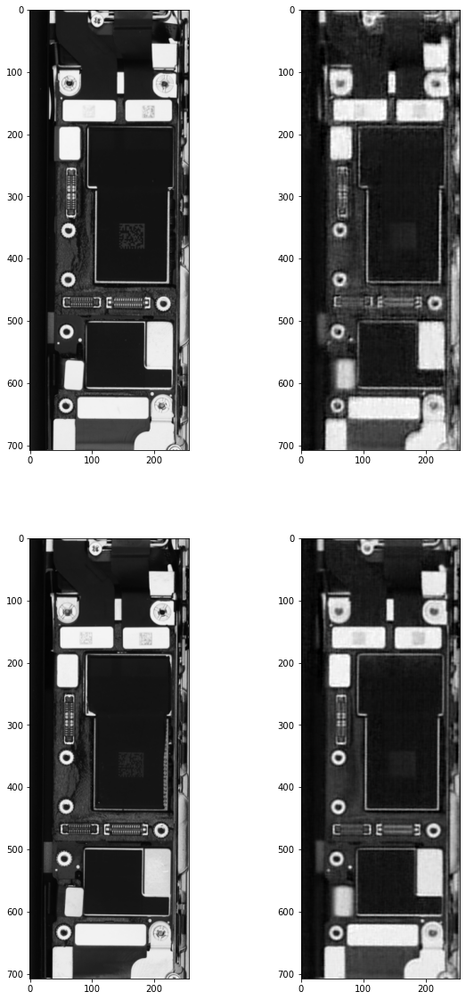

----------
val batch 0 / 268
val: autoencoder loss 0.009812925942242146, classification loss 0.8683494329452515, minibatch_loss 0.09664787352085114
----------
val_epoch_loss 0.07030495453570317
val_epoch_partial_auc 0.5254267073451196
val_score [[0.48195943]
 [0.10900577]
 [0.50864512]
 ...
 [0.57987463]
 [0.42652002]
 [0.54132801]]


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


----------
train_batch_idx 1300
train: autoencoder loss 0.009824889712035656, classification loss 0.6290200352668762, minibatch_loss 0.07272689044475555


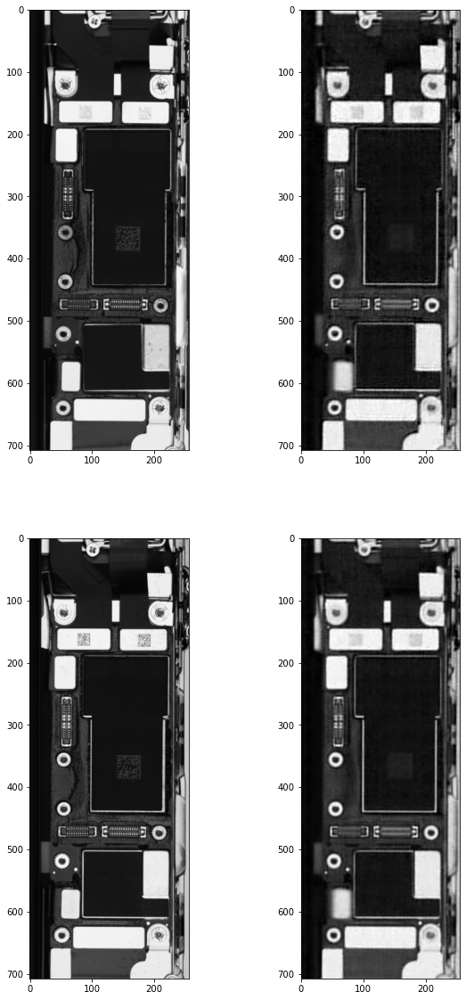

train batch 1400 / 1790
----------
train_batch_idx 1400
train: autoencoder loss 0.009901870042085648, classification loss 0.6017394065856934, minibatch_loss 0.07007580995559692


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


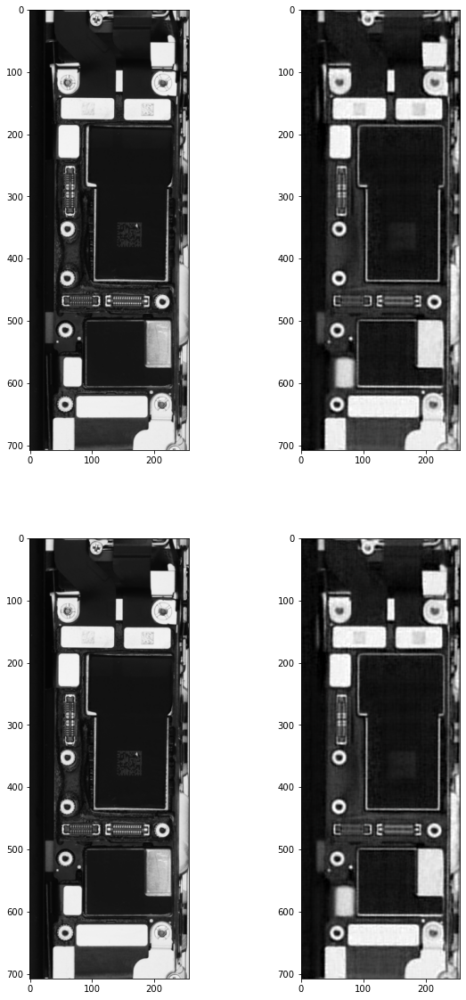

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


----------
train_batch_idx 1500
train: autoencoder loss 0.008536101318895817, classification loss 0.6730824708938599, minibatch_loss 0.07584434747695923


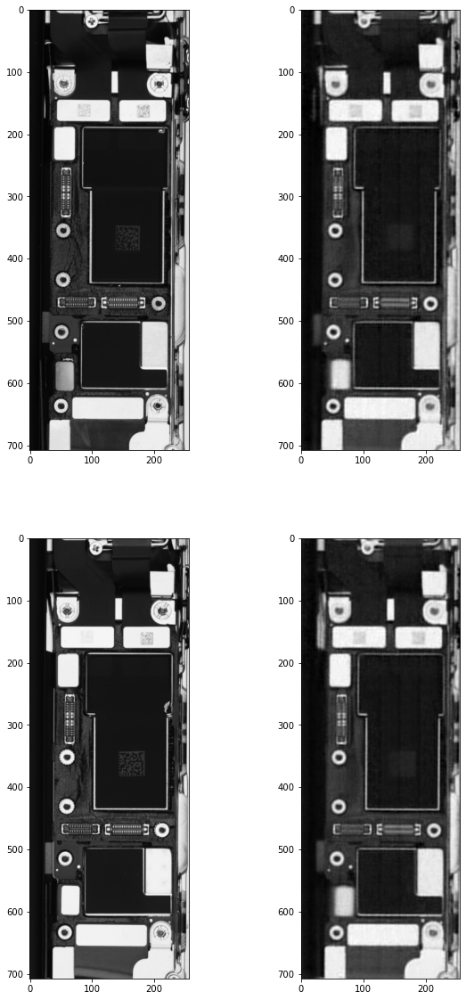

----------
val batch 0 / 268
val: autoencoder loss 0.008536101318895817, classification loss 0.6730824708938599, minibatch_loss 0.07584434747695923
----------
val_epoch_loss 0.07246723456947661
val_epoch_partial_auc 0.5083096534549867
val_score [[0.56882745]
 [0.03239975]
 [0.45915994]
 ...
 [0.56882745]
 [0.56882745]
 [0.43524998]]


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train batch 1600 / 1790
----------
train_batch_idx 1600
train: autoencoder loss 0.011712619103491306, classification loss 0.6374377012252808, minibatch_loss 0.07545638829469681


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


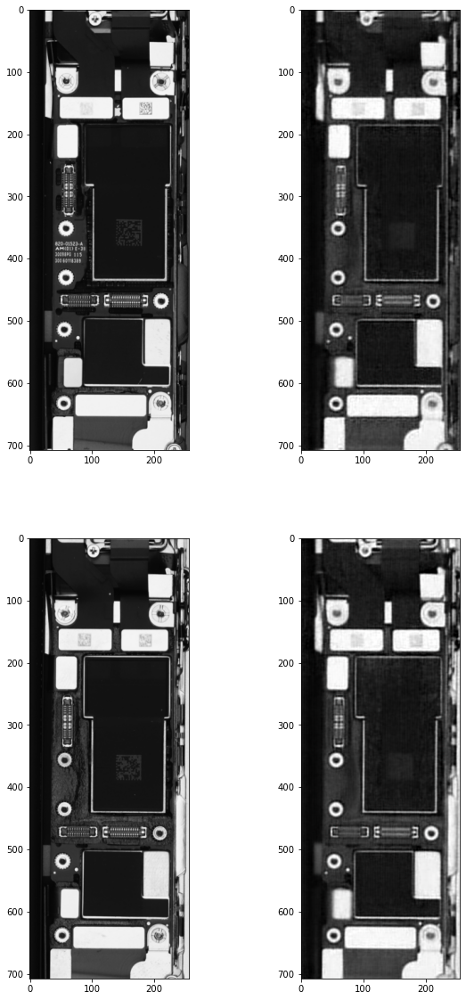

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


----------
train_batch_idx 1700
train: autoencoder loss 0.008814007043838501, classification loss 0.5701019167900085, minibatch_loss 0.06582419574260712


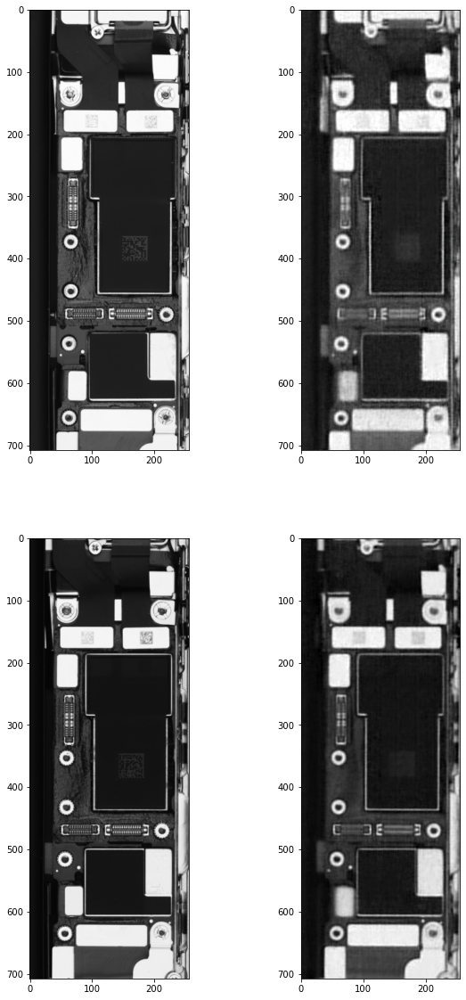

train_epoch_loss 0.07246723456947661 train_epoch_partial_auc 0.515034532841406
----------
Epoch 2/5
----------
train batch 0 / 1790
----------
train_batch_idx 0
train: autoencoder loss 0.010914405807852745, classification loss 0.4774322509765625, minibatch_loss 0.058657631278038025


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


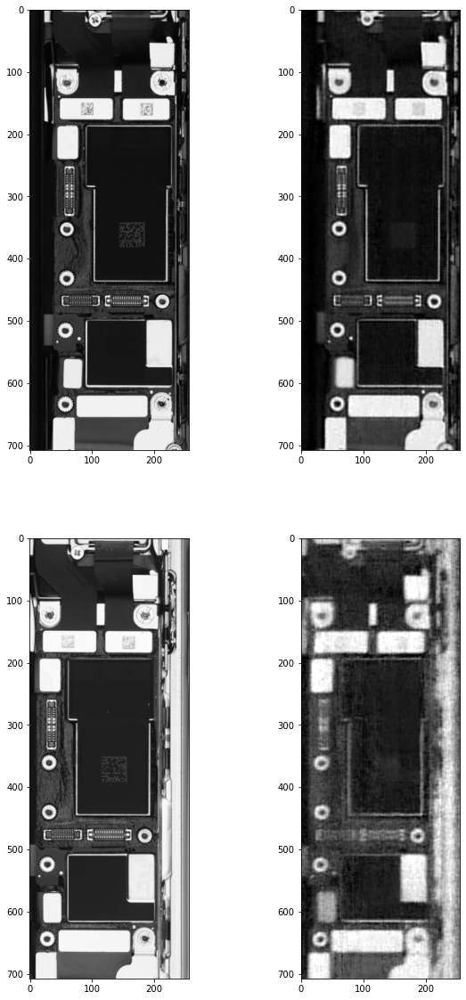

----------
val batch 0 / 268
val: autoencoder loss 0.010914405807852745, classification loss 0.4774322509765625, minibatch_loss 0.058657631278038025
----------
val_epoch_loss 0.07232015582718956
val_epoch_partial_auc 0.5054202734896482
val_score [[0.5638473 ]
 [0.14484754]
 [0.5638473 ]
 ...
 [0.5638473 ]
 [0.5638473 ]
 [0.5638473 ]]


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


----------
train_batch_idx 100
train: autoencoder loss 0.00977136380970478, classification loss 0.6234771609306335, minibatch_loss 0.0721190795302391


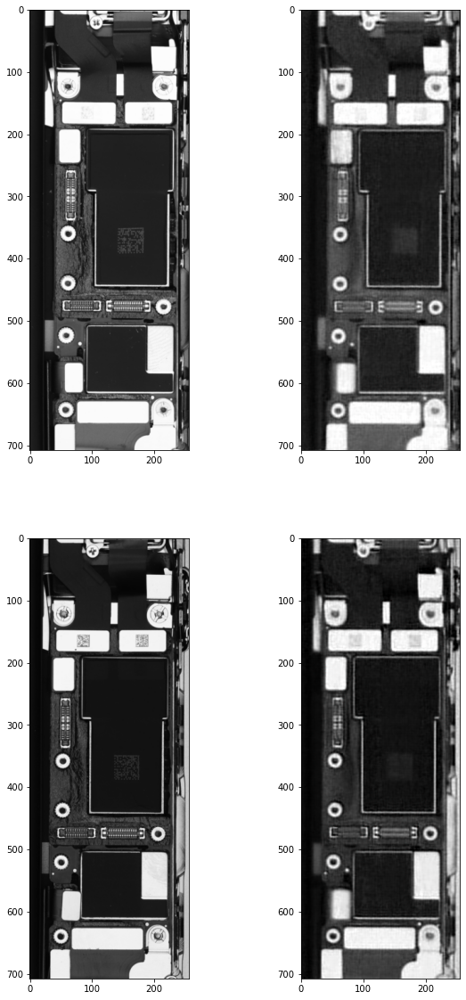

train batch 200 / 1790
----------
train_batch_idx 200
train: autoencoder loss 0.01040525734424591, classification loss 0.7113810777664185, minibatch_loss 0.08154336363077164


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


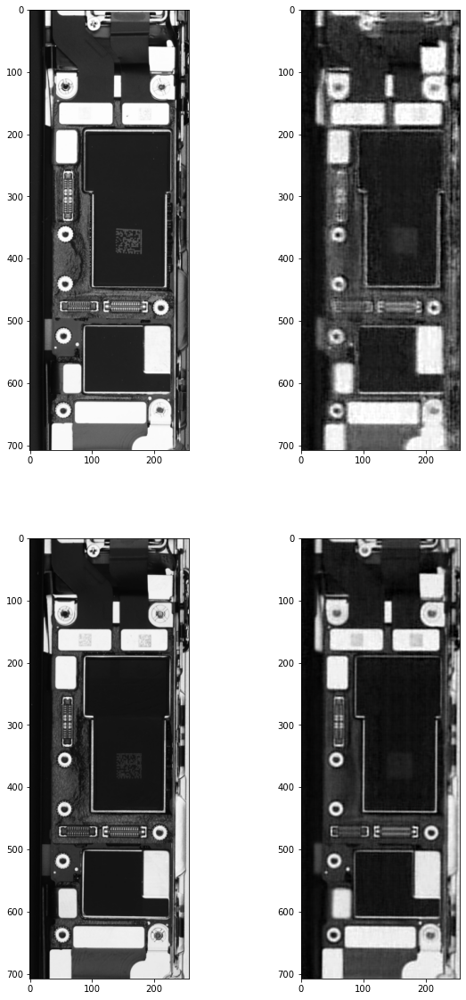

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


----------
train_batch_idx 300
train: autoencoder loss 0.009264613501727581, classification loss 0.596407949924469, minibatch_loss 0.06890540570020676


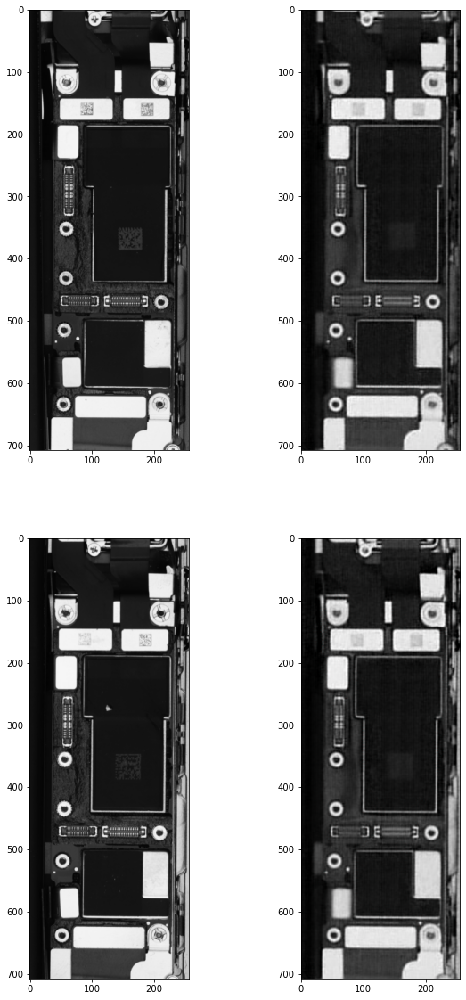

----------
val batch 0 / 268
val: autoencoder loss 0.009264613501727581, classification loss 0.596407949924469, minibatch_loss 0.06890540570020676
----------
val_epoch_loss 0.07388963008216068
val_epoch_partial_auc 0.5162282050860109
val_score [[0.5785085 ]
 [0.31993413]
 [0.50716913]
 ...
 [0.5785085 ]
 [0.53981394]
 [0.5785085 ]]


/root/miniconda3/envs/olaf/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


In [ ]:
encoder, decoder, classifier = train_eval_model(encoder=encoder,
                         decoder=decoder,
                         classifier=classifier,
                         classification_loss_fn=classification_criterion,
                         autoencoder_loss_fn=autoencoder_criterion,
                         encoder_optimizer=encoder_optimizer,
                         decoder_optimizer=decoder_optimizer,
                         classifier_optimizer=classifier_optimizer,
                         train_loader=transformed_train_loader,
                         val_loader=transformed_val_loader,
                         to_save='../models/simul/20210304/20210304_simulation',
                         checkpoint=None,
                         num_epochs=5,
                         verbose=True,
                         alpha=1,
                         beta=1/10,
                         evaluation=True)

## Past Code

best_partial_auc 0
----------
Epoch 1/3
----------
train batch 0 / 879


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


----------
train_batch_idx 0
train: autoencoder loss 0.006378192454576492, classification loss 0.58488929271698, minibatch_loss 0.58488929271698


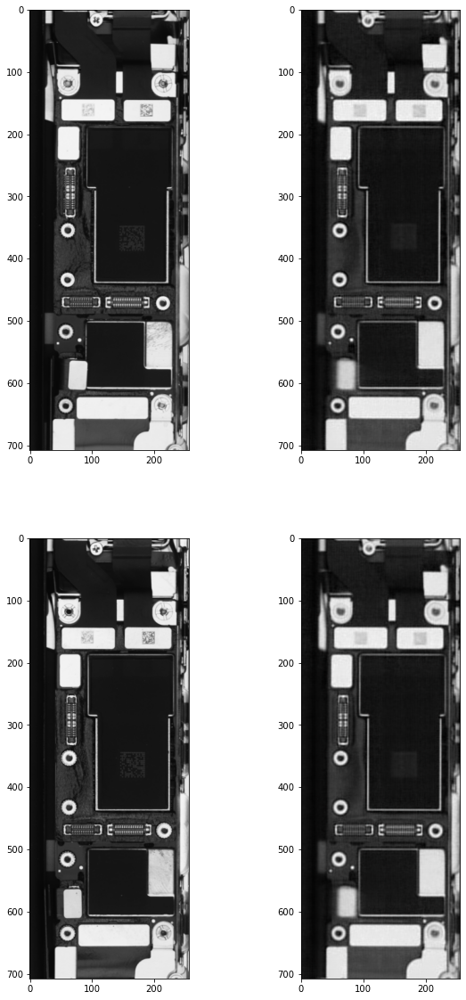

----------
val batch 0 / 240
val: autoencoder loss 0.006378192454576492, classification loss 0.58488929271698, minibatch_loss 0.58488929271698
----------
val_epoch_loss 0.3890723151465257
val_epoch_partial_auc 0.7957195073448287
----------
saving weights


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train batch 200 / 879


In [ ]:
encoder, decoder, classifier = train_eval_model(encoder=encoder,
                         decoder=decoder,
                         classifier=classifer,
                         classification_loss_fn=classification_criterion,
                         autoencoder_loss_fn=autoencoder_criterion,
                         encoder_optimizer=encoder_optimizer,
                         decoder_optimizer=decoder_optimizer,
                         classifier_optimizer=classifier_optimizer,
                         train_loader=transformed_train_loader,
                         val_loader=transformed_val_loader,
                         to_save='../models/20201113_autoencoder_classifier_simul/alpha10_dropout0.2_no_au_loss',
                         checkpoint=None,
                         num_epochs=3,
                         verbose=True,
                         alpha=0,
                         evaluation=True)

best_partial_auc 0
Epoch 1/3
----------
train batch 0 / 879
----------
train_batch_idx 0
train: autoencoder loss 0.006189991254359484, classification loss 0.5524125099182129, minibatch_loss 0.6143124103546143


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


----------
val batch 0 / 240
val: autoencoder loss 0.006189991254359484, classification loss 0.5524125099182129, minibatch_loss 0.6143124103546143


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


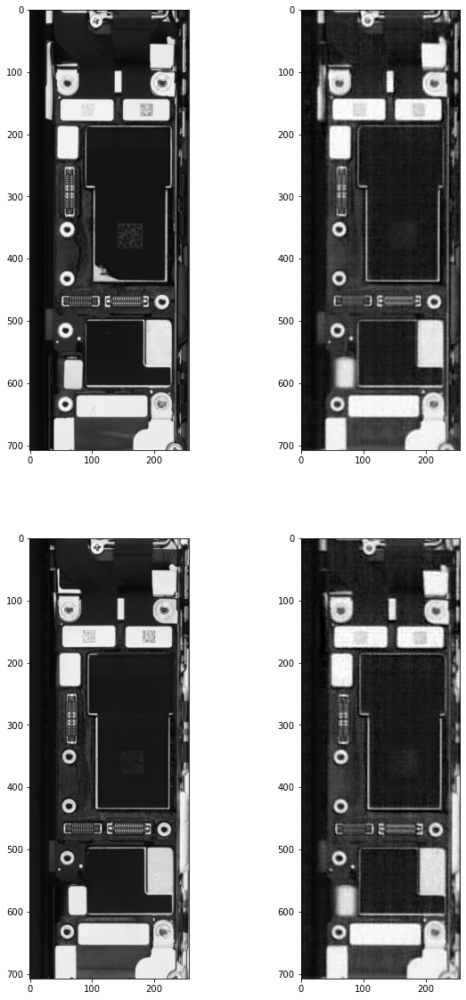

----------
val batch 200 / 240
val: autoencoder loss 0.006801692768931389, classification loss 0.6436007022857666, minibatch_loss 0.06801693141460419
----------
val_epoch_loss 0.5496804210046927
val_epoch_partial_auc 0.6706274755055244
----------
saving weights


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


----------
train_batch_idx 100
train: autoencoder loss 0.006891046185046434, classification loss 0.5853977203369141, minibatch_loss 0.6543081998825073
train batch 200 / 879
----------
train_batch_idx 200
train: autoencoder loss 0.006456506904214621, classification loss 0.533428966999054, minibatch_loss 0.5979940295219421
----------
train_batch_idx 300
train: autoencoder loss 0.0067754024639725685, classification loss 0.7356728315353394, minibatch_loss 0.8034268617630005
train batch 400 / 879
----------
train_batch_idx 400
train: autoencoder loss 0.007270110305398703, classification loss 0.6940363645553589, minibatch_loss 0.7667374610900879
----------
val batch 0 / 240
val: autoencoder loss 0.007270110305398703, classification loss 0.6940363645553589, minibatch_loss 0.7667374610900879


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


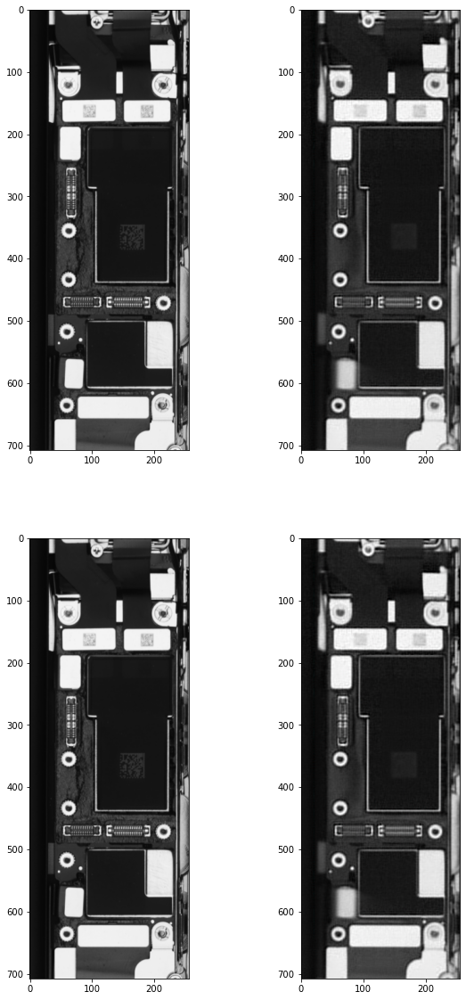

----------
val batch 200 / 240
val: autoencoder loss 0.006781944073736668, classification loss 0.5406500101089478, minibatch_loss 0.06781943887472153
----------
val_epoch_loss 0.5217216870747506
val_epoch_partial_auc 0.6556410592961215


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


----------
train_batch_idx 500
train: autoencoder loss 0.00642058253288269, classification loss 0.581337571144104, minibatch_loss 0.6455433964729309
train batch 600 / 879
----------
train_batch_idx 600
train: autoencoder loss 0.0073564667254686356, classification loss 0.6141493916511536, minibatch_loss 0.6877140402793884
----------
train_batch_idx 700
train: autoencoder loss 0.0062836045399308205, classification loss 0.49338704347610474, minibatch_loss 0.5562230944633484
train batch 800 / 879
----------
train_batch_idx 800
train: autoencoder loss 0.00812629796564579, classification loss 0.46491730213165283, minibatch_loss 0.0812629759311676
----------
val batch 0 / 240
val: autoencoder loss 0.00812629796564579, classification loss 0.46491730213165283, minibatch_loss 0.0812629759311676


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


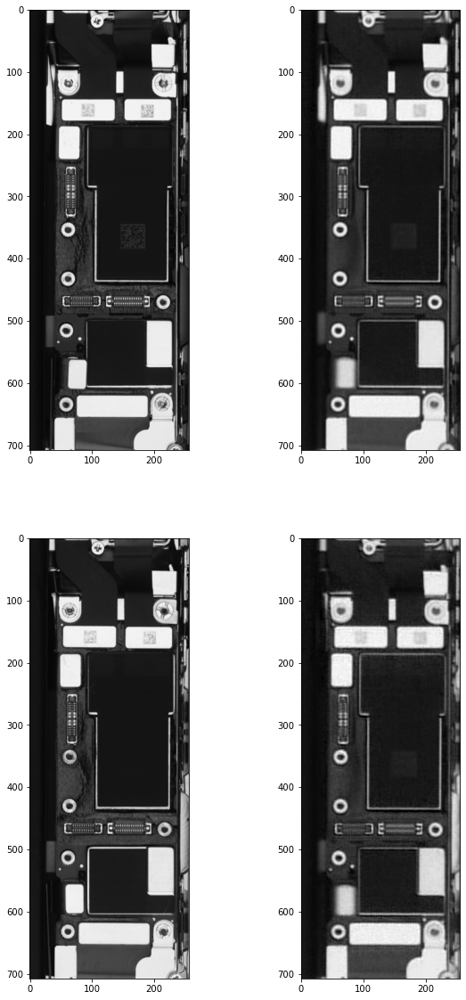

----------
val batch 200 / 240
val: autoencoder loss 0.006332099437713623, classification loss 0.5738679766654968, minibatch_loss 0.06332099437713623
----------
val_epoch_loss 0.5271287238691003
val_epoch_partial_auc 0.6964231166162929
----------
saving weights


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train_epoch_loss 0.5271287238691003 train_epoch_partial_auc 0.5822496294567919
Epoch 2/3
----------
train batch 0 / 879
----------
train_batch_idx 0


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: autoencoder loss 0.005963921546936035, classification loss 0.5208480358123779, minibatch_loss 0.5804872512817383
----------
val batch 0 / 240
val: autoencoder loss 0.005963921546936035, classification loss 0.5208480358123779, minibatch_loss 0.5804872512817383


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


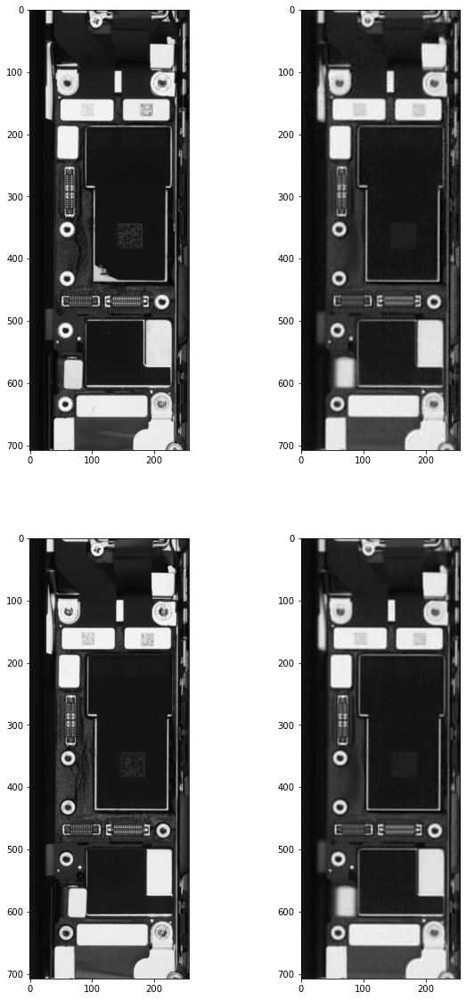

----------
val batch 200 / 240
val: autoencoder loss 0.00614244444295764, classification loss 0.5726684331893921, minibatch_loss 0.06142444536089897
----------
val_epoch_loss 0.5253323423986633
val_epoch_partial_auc 0.6949957446100868


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


----------
train_batch_idx 100
train: autoencoder loss 0.006857225671410561, classification loss 0.5700734257698059, minibatch_loss 0.6386456489562988
train batch 200 / 879
----------
train_batch_idx 200
train: autoencoder loss 0.006694994401186705, classification loss 0.47258448600769043, minibatch_loss 0.5395344495773315
----------
train_batch_idx 300
train: autoencoder loss 0.006882700137794018, classification loss 0.7096387147903442, minibatch_loss 0.778465747833252
train batch 400 / 879
----------
train_batch_idx 400
train: autoencoder loss 0.007642658893018961, classification loss 0.6607436537742615, minibatch_loss 0.7371702194213867
----------
val batch 0 / 240
val: autoencoder loss 0.007642658893018961, classification loss 0.6607436537742615, minibatch_loss 0.7371702194213867


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


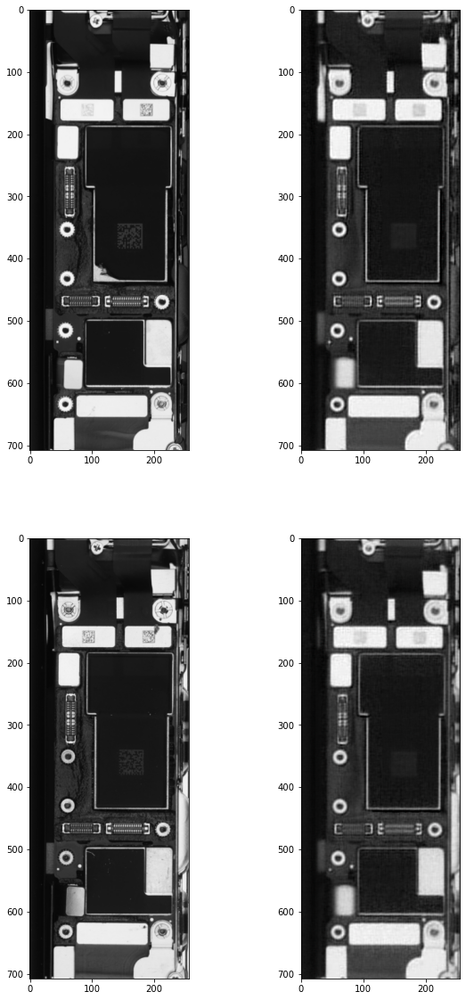

----------
val batch 200 / 240
val: autoencoder loss 0.006695758085697889, classification loss 0.5038127899169922, minibatch_loss 0.06695757806301117
----------
val_epoch_loss 0.5168682544181744
val_epoch_partial_auc 0.6462592064009617


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


----------
train_batch_idx 500
train: autoencoder loss 0.006799180991947651, classification loss 0.5786610841751099, minibatch_loss 0.64665287733078
train batch 600 / 879
----------
train_batch_idx 600
train: autoencoder loss 0.0072445315308868885, classification loss 0.6029657125473022, minibatch_loss 0.6754110455513
----------
train_batch_idx 700
train: autoencoder loss 0.006428126711398363, classification loss 0.5199528336524963, minibatch_loss 0.5842341184616089
train batch 800 / 879
----------
train_batch_idx 800
train: autoencoder loss 0.0081416554749012, classification loss 0.5832391977310181, minibatch_loss 0.081416554749012
----------
val batch 0 / 240
val: autoencoder loss 0.0081416554749012, classification loss 0.5832391977310181, minibatch_loss 0.081416554749012


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


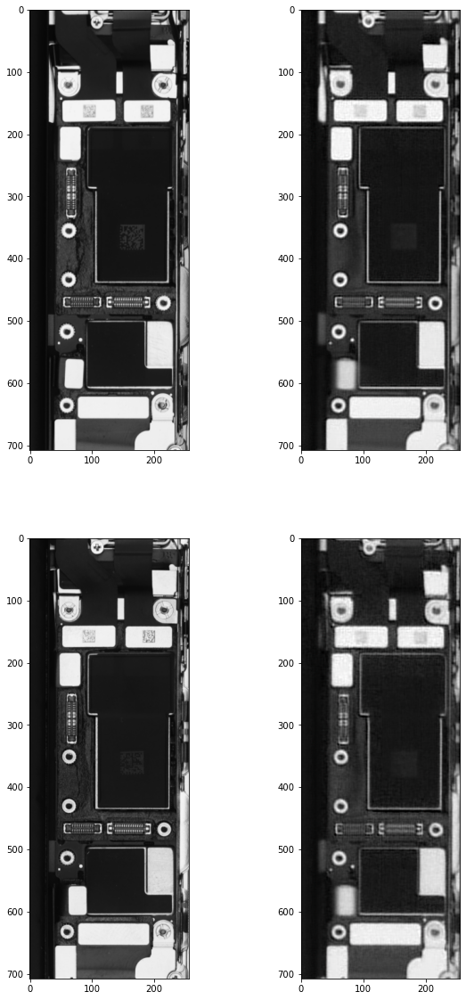

----------
val batch 200 / 240
val: autoencoder loss 0.006539041176438332, classification loss 0.5053073763847351, minibatch_loss 0.06539040803909302
----------
val_epoch_loss 0.5068951950253298
val_epoch_partial_auc 0.7096040359190938
----------
saving weights


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train_epoch_loss 0.5068951950253298 train_epoch_partial_auc 0.6228664453234947
Epoch 3/3
----------
train batch 0 / 879
----------
train_batch_idx 0
train: autoencoder loss 0.006102308165282011, classification loss 0.5316738486289978, minibatch_loss 0.5926969051361084


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


----------
val batch 0 / 240
val: autoencoder loss 0.006102308165282011, classification loss 0.5316738486289978, minibatch_loss 0.5926969051361084


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


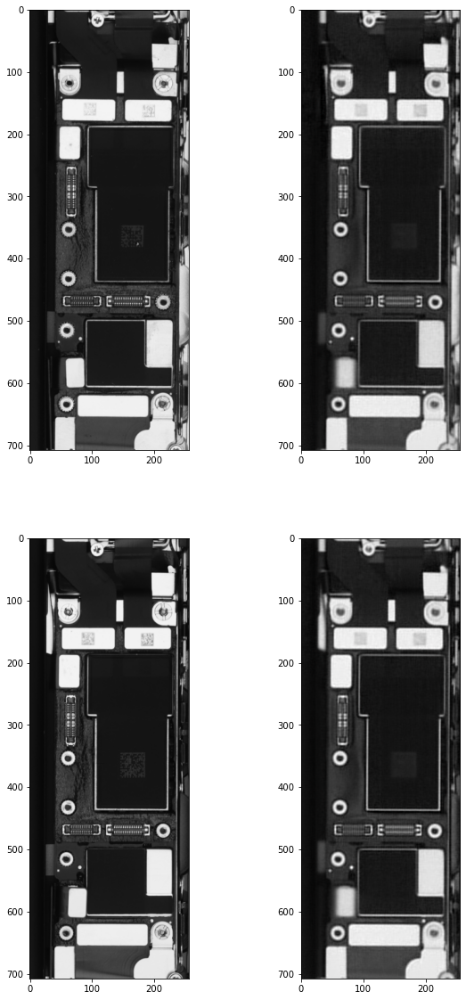

----------
val batch 200 / 240
val: autoencoder loss 0.006227703299373388, classification loss 0.5127992630004883, minibatch_loss 0.06227703392505646
----------
val_epoch_loss 0.5060604381685455
val_epoch_partial_auc 0.7088576846759044


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


----------
train_batch_idx 100
train: autoencoder loss 0.007129850797355175, classification loss 0.5944939851760864, minibatch_loss 0.6657924652099609
train batch 200 / 879
----------
train_batch_idx 200
train: autoencoder loss 0.006907768081873655, classification loss 0.4419846534729004, minibatch_loss 0.5110623240470886
----------
train_batch_idx 300
train: autoencoder loss 0.006928144954144955, classification loss 0.7210403680801392, minibatch_loss 0.7903218269348145
train batch 400 / 879
----------
train_batch_idx 400
train: autoencoder loss 0.007237168028950691, classification loss 0.6483352184295654, minibatch_loss 0.7207068800926208
----------
val batch 0 / 240
val: autoencoder loss 0.007237168028950691, classification loss 0.6483352184295654, minibatch_loss 0.7207068800926208


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


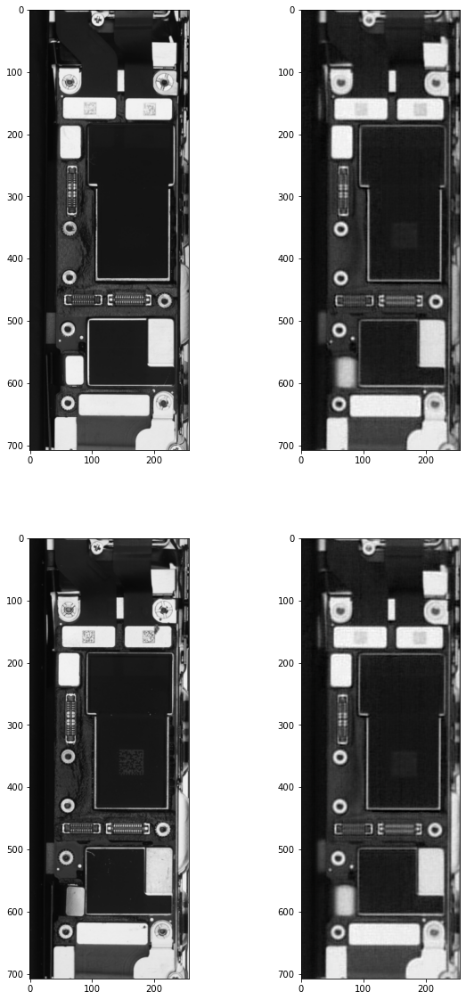

----------
val batch 200 / 240
val: autoencoder loss 0.0067375884391367435, classification loss 0.4948890805244446, minibatch_loss 0.06737588346004486
----------
val_epoch_loss 0.5130079703405499
val_epoch_partial_auc 0.655458925836245


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


----------
train_batch_idx 500
train: autoencoder loss 0.006927777547389269, classification loss 0.601826548576355, minibatch_loss 0.6711043119430542
train batch 600 / 879
----------
train_batch_idx 600
train: autoencoder loss 0.007716647814959288, classification loss 0.5811301469802856, minibatch_loss 0.6582966446876526
----------
train_batch_idx 700
train: autoencoder loss 0.006903421133756638, classification loss 0.5036894083023071, minibatch_loss 0.5727236270904541


KeyboardInterrupt: 

In [97]:
encoder, decoder, classifier = train_eval_model(encoder=encoder,
                         decoder=decoder,
                         classifier=classifer,
                         classification_loss_fn=classification_criterion,
                         autoencoder_loss_fn=autoencoder_criterion,
                         encoder_optimizer=encoder_optimizer,
                         decoder_optimizer=decoder_optimizer,
                         classifier_optimizer=classifier_optimizer,
                         train_loader=transformed_train_loader,
                         val_loader=transformed_val_loader,
                         to_save='../models/20201112_autoencoder_classifier_simul/alpha10',
                         checkpoint='../models/20201112_autoencoder_classifier_simul/alpha10_1_800.pth',
                         num_epochs=10,
                         verbose=True,
                         alpha=10,
                         evaluation=True)

Epoch 1/3
----------
train batch 0 / 879
----------
train_batch_idx 0
train: autoencoder loss 0.0062474897131323814, classification loss 0.5983301997184753, minibatch_loss 1.2230792045593262


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


----------
val batch 0 / 240
val: autoencoder loss 0.0062474897131323814, classification loss 0.5983301997184753, minibatch_loss 1.2230792045593262


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


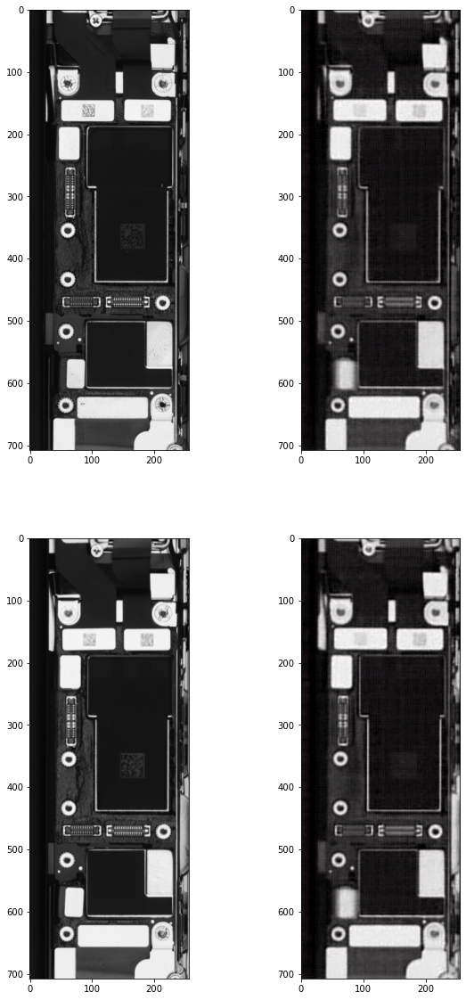

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


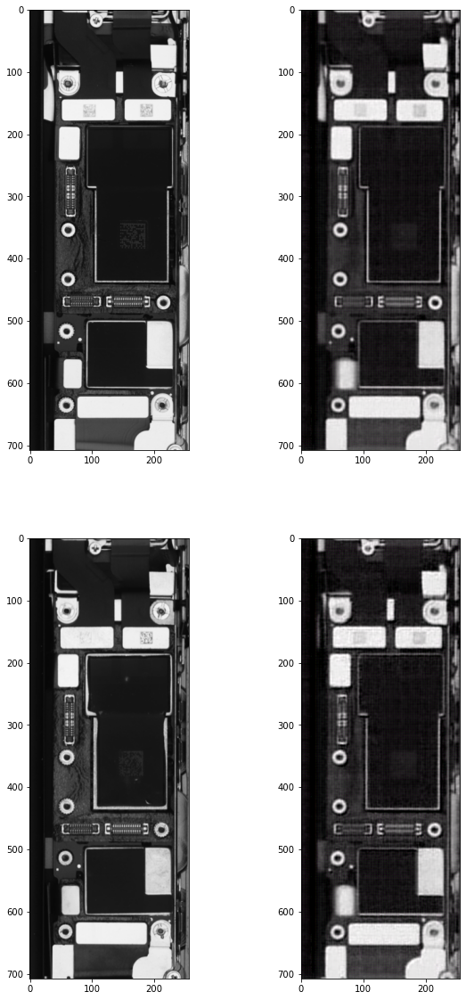

----------
val_epoch_loss 1.4123990582923094
val_epoch_partial_auc 0.508679154290995
----------
saving weights


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


----------
train_batch_idx 100
train: autoencoder loss 0.007324911188334227, classification loss 0.6788560152053833, minibatch_loss 1.4113471508026123
train batch 200 / 879
----------
train_batch_idx 200
train: autoencoder loss 0.007043659687042236, classification loss 0.6651148796081543, minibatch_loss 1.369480848312378
----------
train_batch_idx 300
train: autoencoder loss 0.0073897261172533035, classification loss 0.7120457887649536, minibatch_loss 1.4510183334350586
----------
val batch 0 / 240
val: autoencoder loss 0.0073897261172533035, classification loss 0.7120457887649536, minibatch_loss 1.4510183334350586


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


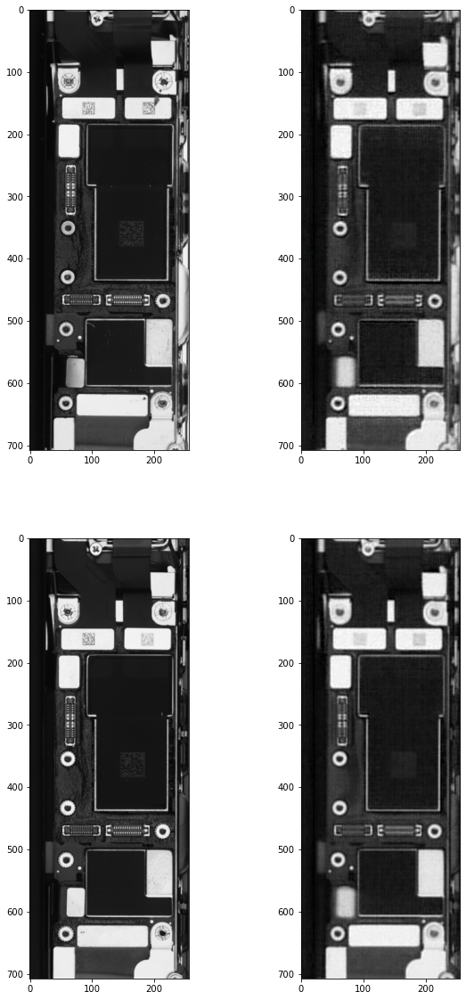

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


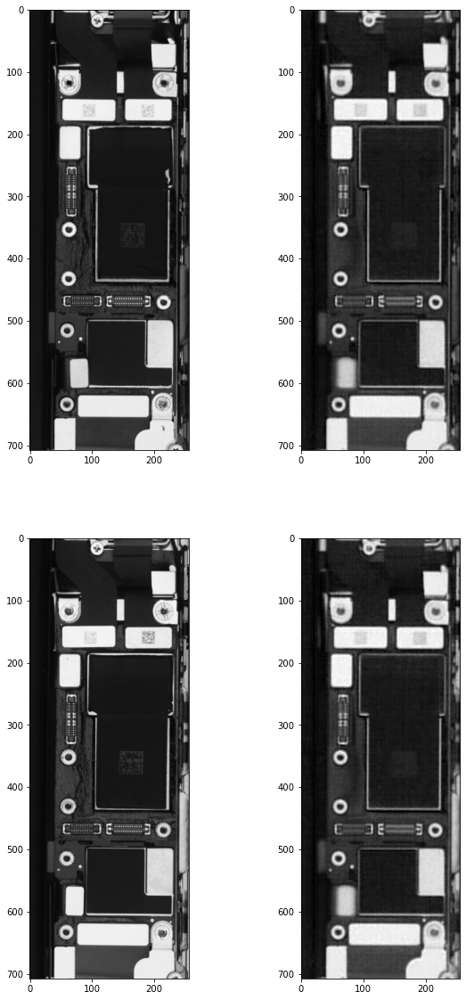

----------
val_epoch_loss 1.2845264079670111
val_epoch_partial_auc 0.632381428642981
----------
saving weights


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train batch 400 / 879
----------
train_batch_idx 400
train: autoencoder loss 0.00719049759209156, classification loss 0.6808180809020996, minibatch_loss 1.3998677730560303
----------
train_batch_idx 500
train: autoencoder loss 0.006846897769719362, classification loss 0.6212834119796753, minibatch_loss 1.3059731721878052
train batch 600 / 879
----------
train_batch_idx 600
train: autoencoder loss 0.007814080454409122, classification loss 0.6583572626113892, minibatch_loss 1.4397653341293335
----------
val batch 0 / 240
val: autoencoder loss 0.007814080454409122, classification loss 0.6583572626113892, minibatch_loss 1.4397653341293335


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


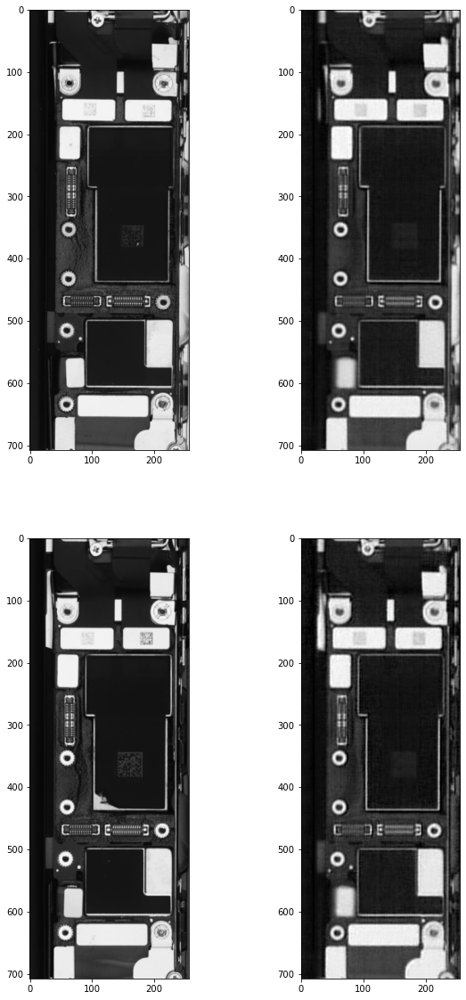

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


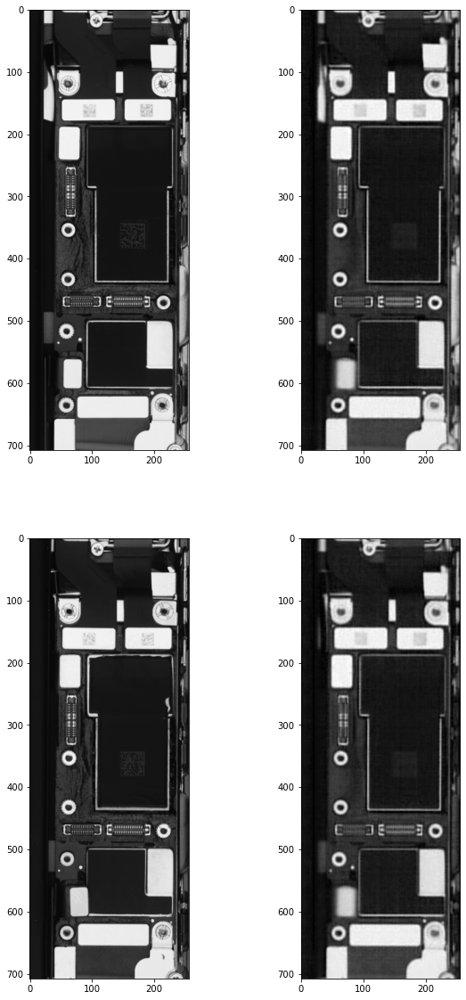

----------
val_epoch_loss 1.2567435624698797
val_epoch_partial_auc 0.6324823939305213
----------
saving weights


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


----------
train_batch_idx 700
train: autoencoder loss 0.006399220321327448, classification loss 0.5996378660202026, minibatch_loss 1.2395598888397217
train batch 800 / 879
----------
train_batch_idx 800
train: autoencoder loss 0.008160628378391266, classification loss 0.6116929650306702, minibatch_loss 0.8160628080368042
train_epoch_loss 1.2567435624698797 train_epoch_partial_auc 0.5776207665329021
Epoch 2/3
----------
train batch 0 / 879
----------
train_batch_idx 0
train: autoencoder loss 0.006463808938860893, classification loss 0.6301102042198181, minibatch_loss 1.2764911651611328


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


----------
val batch 0 / 240
val: autoencoder loss 0.006463808938860893, classification loss 0.6301102042198181, minibatch_loss 1.2764911651611328


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


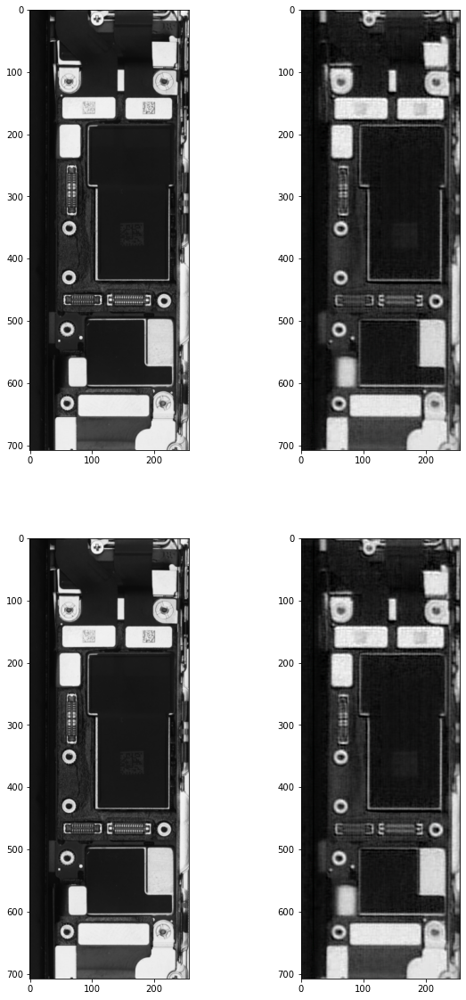

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


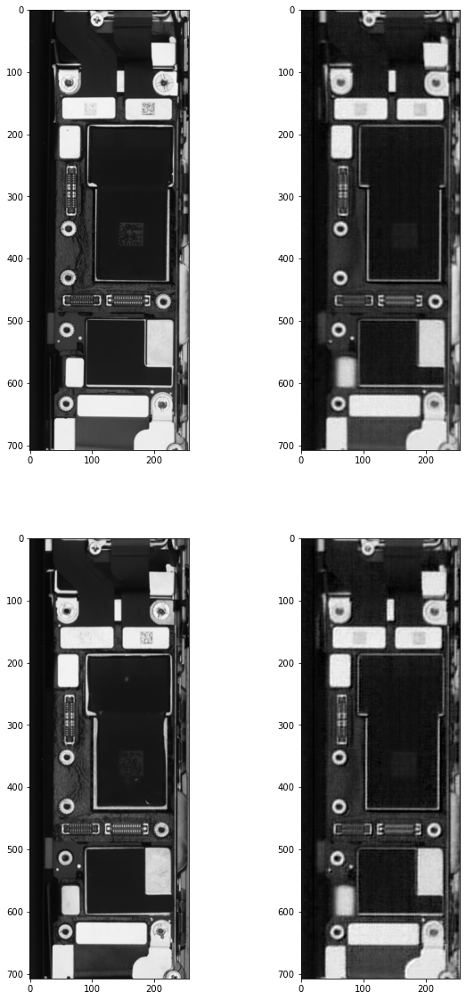

----------
val_epoch_loss 1.2574132896959782
val_epoch_partial_auc 0.646819464761234


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


----------
train_batch_idx 100
train: autoencoder loss 0.006960730534046888, classification loss 0.6468173265457153, minibatch_loss 1.3428903818130493
train batch 200 / 879
----------
train_batch_idx 200
train: autoencoder loss 0.006825338117778301, classification loss 0.5763298273086548, minibatch_loss 1.2588636875152588
----------
train_batch_idx 300
train: autoencoder loss 0.007330514490604401, classification loss 0.73263019323349, minibatch_loss 1.465681552886963
----------
val batch 0 / 240
val: autoencoder loss 0.007330514490604401, classification loss 0.73263019323349, minibatch_loss 1.465681552886963


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


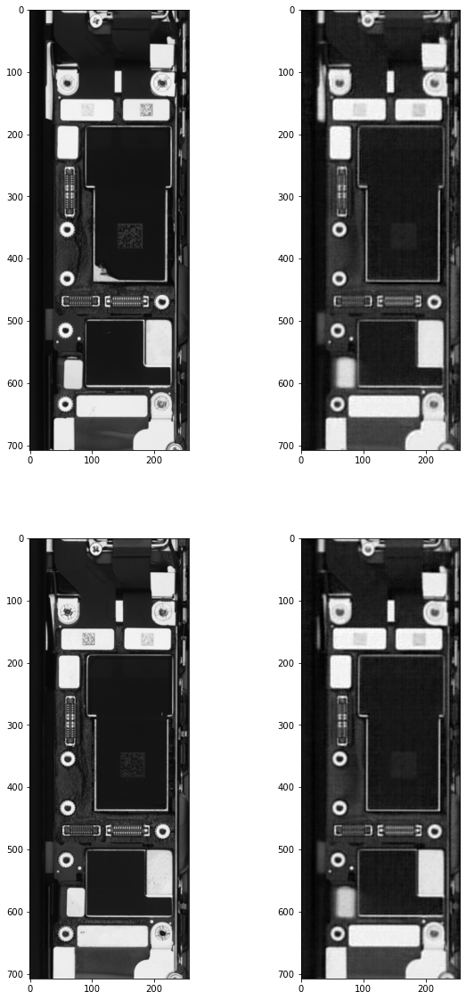

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


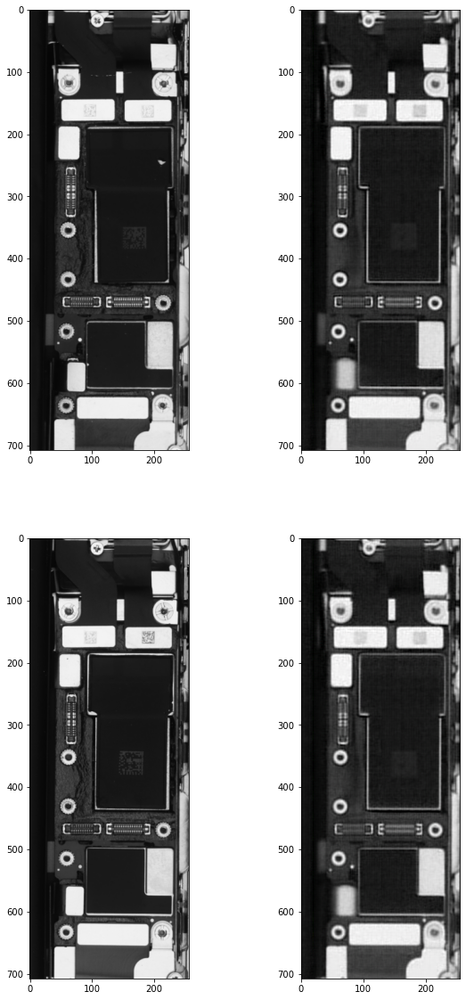

----------
val_epoch_loss 1.2186830535531044
val_epoch_partial_auc 0.6538197246973565
----------
saving weights


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train batch 400 / 879
----------
train_batch_idx 400
train: autoencoder loss 0.00709048006683588, classification loss 0.662625789642334, minibatch_loss 1.371673822402954
----------
train_batch_idx 500
train: autoencoder loss 0.006758582312613726, classification loss 0.5972332954406738, minibatch_loss 1.2730915546417236
train batch 600 / 879
----------
train_batch_idx 600
train: autoencoder loss 0.007182481233030558, classification loss 0.6419557332992554, minibatch_loss 1.3602038621902466
----------
val batch 0 / 240
val: autoencoder loss 0.007182481233030558, classification loss 0.6419557332992554, minibatch_loss 1.3602038621902466


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


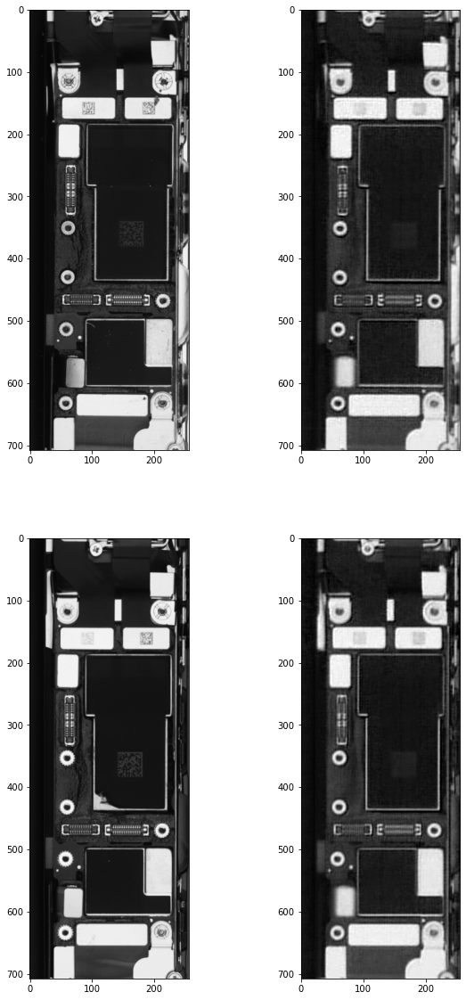

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


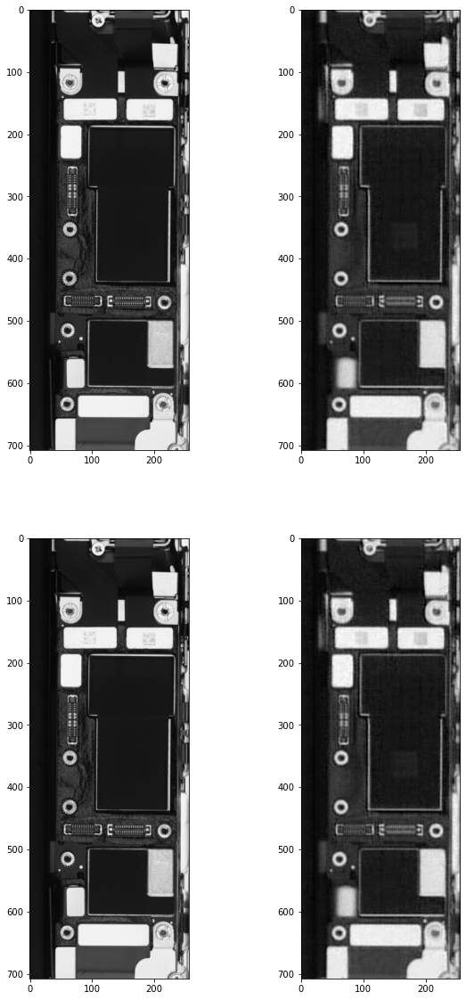

----------
val_epoch_loss 1.2048114317158858
val_epoch_partial_auc 0.6714589543440909
----------
saving weights


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


----------
train_batch_idx 700
train: autoencoder loss 0.006130481604486704, classification loss 0.5592834949493408, minibatch_loss 1.1723315715789795
train batch 800 / 879
----------
train_batch_idx 800
train: autoencoder loss 0.007816025987267494, classification loss 0.5776561498641968, minibatch_loss 0.7816026210784912
train_epoch_loss 1.2048114317158858 train_epoch_partial_auc 0.5970071382881069
Epoch 3/3
----------
train batch 0 / 879
----------
train_batch_idx 0
train: autoencoder loss 0.006362149491906166, classification loss 0.5706169009208679, minibatch_loss 1.206831932067871


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


----------
val batch 0 / 240
val: autoencoder loss 0.006362149491906166, classification loss 0.5706169009208679, minibatch_loss 1.206831932067871


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


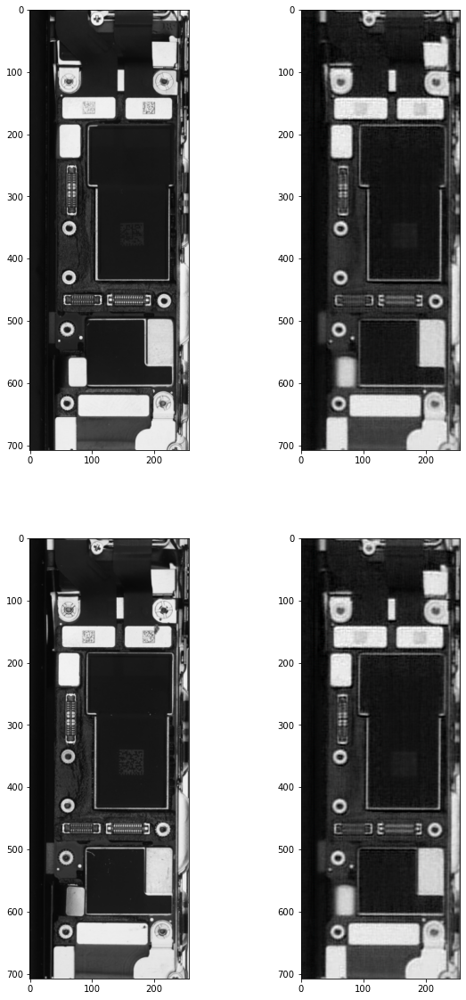

KeyboardInterrupt: 

In [86]:
encoder, decoder, classifier = train_eval_model(encoder=encoder,
                         decoder=decoder,
                         classifier=classifer,
                         classification_loss_fn=classification_criterion,
                         autoencoder_loss_fn=autoencoder_criterion,
                         encoder_optimizer=encoder_optimizer,
                         decoder_optimizer=decoder_optimizer,
                         classifier_optimizer=classifier_optimizer,
                         train_loader=transformed_train_loader,
                         val_loader=transformed_val_loader,
                         to_save='../models/20201112_autoencoder_classifier_simul/',
                         checkpoint=None,
                         num_epochs=3,
                         verbose=True,
                         alpha=100,
                         evaluation=True)

## Evaluate Autoencoder and Classifier

In [87]:
def eval_model(encoder,
               classifier,
                 val_loader,
                 checkpoint, num_epochs = 1, verbose = True, alpha=10):
    if checkpoint:
        pt = torch.load(checkpoint)
        encoder.load_state_dict(pt['encoder'])
#         decoder.load_state_dict(pt['decoder'])
        classifier.load_state_dict(pt['classifier'])
    else:
        encoder_weight = copy.deepcopy(encoder.state_dict())
#         decoder_weight = copy.deepcopy(decoder.state_dict())
        classifier_weight = copy.deepcopy(classifier.state_dict())
        
    val_loss = []
        
    start_time = time.time()
                
    encoder.eval()
    classifier.eval()
    val_running_loss = 0.0
    val_truths = []
    val_scores = []

    for val_batch_idx, data in enumerate(val_loader):
        if val_batch_idx % 100 == 0:
            print('-' * 10)
            print('val batch {} / {}'.format(val_batch_idx, len(val_loader)))

        images = data['image']
        labels = data['label']

        images = images.to(device)
        labels = labels.to(device)

        with torch.no_grad():
            z = encoder(images)
            z = z.to(device)
#             reconstruction = decoder(z).to(device)

#             autoencoder_loss = autoencoder_loss_fn(reconstruction, images)


            classification_output = classifier(z)
            score = classification_output

            val_truths += list(labels.cpu().numpy())
            val_scores += [i.tolist() for i in score]
#             if val_batch_idx % 100 == 0:
#                 print('-' * 10)
#                 print('val truth {} val score {}'.format(val_truths, val_scores))
    epoch_scores = np.array(val_scores)
#     print(val_truths)
#     print(epoch_scores)

#         if torch.sum(labels).item() >= 0:
#             minibatch_loss = alpha * autoencoder_loss + classification_loss
#         else:
#             minibatch_loss = alpha * autoencoder_loss

#         if val_batch_idx % 70 == 0:
#             plot(images, reconstruction)

#     epoch_loss = val_running_loss / len(val_loader)
#     epoch_scores = np.array(val_scores)
#     epoch_partial_auc = roc_auc_score(val_truths, epoch_scores, max_fpr=0.05)
#     print('-' * 10)
# #     print('val_epoch_loss {}'.format(epoch_loss))
#     print('val_epoch_partial_auc {}'.format(epoch_partial_auc))

 
                
    return val_truths, epoch_scores

In [24]:
encoder = Encoder().to(device)
decoder = Decoder().to(device)
classifier = Classifier().to(device)


In [21]:
checkpoint = '../models/20201112_autoencoder_classifier_simul/alpha10_9_0.pth'

In [22]:
pt = torch.load(checkpoint)
print(pt['best_loss'])
print(pt['best_partial_auc'])

0.46036806735210123
0.7977883058836432


In [25]:
encoder.load_state_dict(pt['encoder'])
decoder.load_state_dict(pt['decoder'])
classifier.load_state_dict(pt['classifier'])

encoder = encoder.to(device)
classifier= classifier.to(device)

encoder.eval()
decoder.eval()
classifier.eval()

Classifier(
  (main): Sequential(
    (0): Linear(in_features=512, out_features=64, bias=True)
    (1): ReLU()
    (2): Linear(in_features=64, out_features=1, bias=True)
  )
)

In [80]:
val_truths, epoch_scores = eval_model(encoder,
                                    classifier,
                                     transformed_downsampled_train_loader,
                                     checkpoint='../models/20201112_autoencoder_classifier_simul/alpha10_9_0.pth',
                               num_epochs = 1, verbose = True, alpha=10)

----------
val batch 0 / 4
score tensor([[ 0.7668],
        [-0.7646],
        [-0.7252],
        [ 0.8578],
        [-0.7300],
        [-0.7123],
        [ 0.6740],
        [-0.7528]], device='cuda:0')
score tensor([[ 0.8040],
        [-0.7311],
        [ 0.8629],
        [ 0.8623],
        [-0.7411],
        [ 0.8572],
        [ 0.8626],
        [ 0.8786]], device='cuda:0')
[0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1]
[[ 0.76675439]
 [-0.76463759]
 [-0.72517562]
 [ 0.85779917]
 [-0.73004496]
 [-0.71233499]
 [ 0.67398465]
 [-0.75281531]
 [ 0.80402774]
 [-0.73109394]
 [ 0.86285985]
 [ 0.86233759]
 [-0.74112713]
 [ 0.8571977 ]
 [ 0.86257941]
 [ 0.8785516 ]]


ValueError: not enough values to unpack (expected 3, got 2)

In [47]:
torch.cuda.is_available()

True

In [80]:
downsampled_dataloader = {'train': transformed_downsampled_train_loader,
                          'val': transformed_downsampled_train_loader}
dataloader = {'train': transformed_train_loader,
              'val': transformed_val_loader}

----------
val batch 0 / 4
----------
----------
val: autoencoder loss 0.08585051447153091, classification loss 0.6969312429428101, minibatch_loss 1.555436372756958
----------


/root/miniconda3/envs/cnn_fraggle3/lib/python3.7/site-packages/torch/nn/functional.py:2494: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


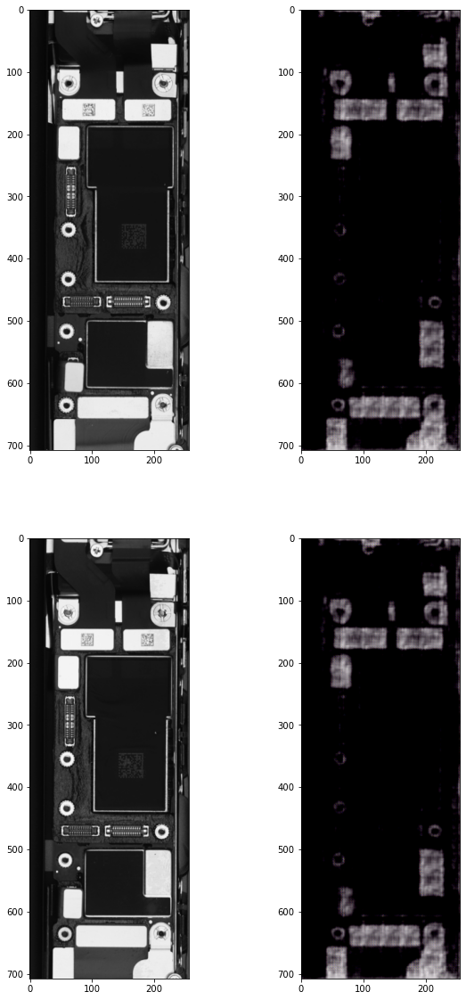

----------
val_epoch_loss 1.184709444642067
val_epoch_partial_auc 0.5
----------


In [118]:
val_truths, epoch_scores, epoch_partial_auc = eval_model(encoder=encoder,
                         decoder=decoder,
                         classifier=classifer,
                         classification_loss_fn=classification_criterion,
                         autoencoder_loss_fn=autoencoder_criterion,
                         val_loader=transformed_downsampled_train_loader,
                         to_save='../models/20201111_autoencoder_classifier_train_test',
                         checkpoint=None,
                         num_epochs=1,
                         verbose=True)

## Unlabeled Prediction

In [95]:
unlabeled_data = pd.read_csv('../data/uncategorized.csv')

In [84]:
transformed_unlabeled_dataset = DeviceDataset(os.path.join(data_path, 'uncategorized.csv'),
                              root_dir = data_path,
                              transform=transform)
batch_size = 8
transformed_unlabeled_loader = prepare_data_loader(transformed_unlabeled_dataset, batch_size)

In [85]:
len(transformed_unlabeled_loader)

253

In [88]:
unlabeled_truths, unlabeled_epoch_scores = eval_model(encoder,
                                                      classifier,
                                                      transformed_unlabeled_loader,
                                                      checkpoint='../models/20201112_autoencoder_classifier_simul/alpha10_9_0.pth',
                                                       num_epochs = 1, verbose = True, alpha=10)

----------
val batch 0 / 253
----------
val batch 100 / 253
----------
val batch 200 / 253


In [89]:
unlabeled_epoch_scores

array([[ 0.74535906],
       [-0.73459035],
       [-0.7474665 ],
       ...,
       [-0.75307494],
       [-0.67852169],
       [ 0.87496459]])

In [96]:
unlabeled_data['auto_encoder'] = unlabeled_epoch_scores

In [104]:
import pickle
pickle.dump(unlabeled_data, open('../predictions/20201113_autoencocder_unlabeled.pkl', 'wb'))

## All labeled

In [91]:
transformed_labeled_dataset = DeviceDataset(os.path.join(data_path, 'shuffled_original_train.csv'),
                              root_dir = data_path,
                              transform=transform)
batch_size = 8
transformed_labeled_loader = prepare_data_loader(transformed_labeled_dataset, batch_size)

In [93]:
labeled_truths, labeled_epoch_scores = eval_model(encoder,
                                                  classifier,
                                                  transformed_labeled_loader,
                                                  checkpoint='../models/20201112_autoencoder_classifier_simul/alpha10_9_0.pth',
                                                   num_epochs = 1, verbose = True, alpha=10)

----------
val batch 0 / 1006
----------
val batch 100 / 1006
----------
val batch 200 / 1006
----------
val batch 300 / 1006
----------
val batch 400 / 1006
----------
val batch 500 / 1006
----------
val batch 600 / 1006
----------
val batch 700 / 1006
----------
val batch 800 / 1006
----------
val batch 900 / 1006
----------
val batch 1000 / 1006


In [99]:
all_labeled = pd.read_csv('../data/shuffled_original_train.csv')
all_labeled['auto_encoder'] = labeled_epoch_scores 

In [102]:
(all_labeled['label']!=labeled_truths).sum()

0

In [103]:
roc_auc_score(labeled_truths, labeled_epoch_scores, max_fpr=0.05)

0.7972585551950533

In [105]:
import pickle
pickle.dump(all_labeled, open('../predictions/20201113_autoencocder_all_labeled.pkl', 'wb'))